# Code 4: Extending Linear Models

```{admonition} This is a reference notebook for the book Bayesian Modeling and Computation in Python
:class: tip, dropdown
The textbook is not needed to use or run this code, though the context and explanation is missing from this notebook.

If you'd like a copy it's available
[from the CRC Press](https://www.routledge.com/Bayesian-Modeling-and-Computation-in-Python/Martin-Kumar-Lao/p/book/9780367894368)
or from [Amazon](https://www.routledge.com/Bayesian-Modeling-and-Computation-in-Python/Martin-Kumar-Lao/p/book/9780367894368).
``

In [1]:
import pymc3 as pm
import matplotlib.pyplot as plt
import arviz as az
import pandas as pd
import numpy as np
from scipy import stats

import theano.tensor as tt
import theano

import datetime
print(f"Last Run {datetime.datetime.now()}")

WARNING (theano.tensor.blas): Using NumPy C-API based implementation for BLAS functions.


Last Run 2022-09-18 20:04:09.159029


In [2]:
az.style.use("arviz-grayscale")
plt.rcParams['figure.dpi'] = 300 

## Transforming Covariates

### Code 4.1

In [3]:
babies = pd.read_csv('../data/babies.csv')

# Add a constant term so we can use a the dot product approach
babies["Intercept"] = 1

babies.head()

,Month,Length,Intercept
0,0,48.5,1
1,0,50.5,1
2,0,50.5,1
3,0,52.0,1
4,0,47.5,1


### Figure 4.1

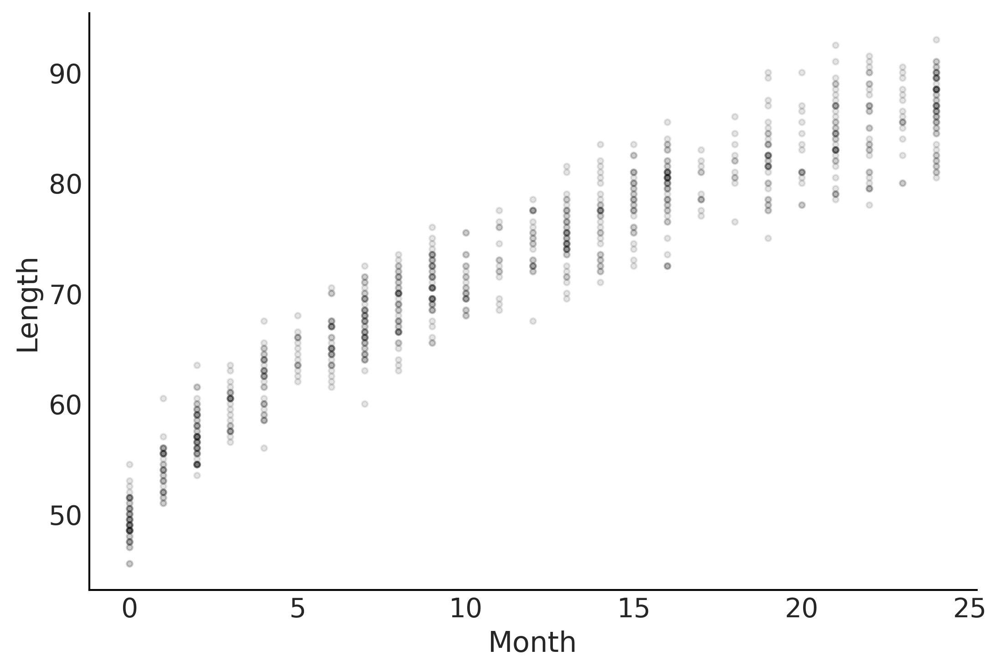

In [4]:
fig, ax = plt.subplots()

ax.plot(babies["Month"], babies["Length"], 'C0.', alpha=0.1)
ax.set_ylabel("Length")
ax.set_xlabel("Month");
plt.savefig('img/chp04/baby_length_scatter.png', dpi=300)

### Code 4.2

In [5]:
with pm.Model() as model_baby_linear:
    β = pm.Normal('β', sigma=10, shape=2)
    
    # Use dot product instead of expanded multiplication
    μ = pm.Deterministic("μ", pm.math.dot(babies[["Intercept", "Month"]], β))
    ϵ = pm.HalfNormal("ϵ", sigma=10)

    length = pm.Normal("length", mu=μ, sigma=ϵ, observed=babies["Length"])

    trace_linear = pm.sample(draws=2000, tune=4000)
    pcc_linear = pm.sample_posterior_predictive(trace_linear)
    inf_data_linear = az.from_pymc3(trace=trace_linear,
                                    posterior_predictive=pcc_linear)

/tmp/ipykernel_19/1205864592.py:10: FutureWarning: In v4.0, pm.sample will return an `arviz.InferenceData` object instead of a `MultiTrace` by default. You can pass return_inferencedata=True or return_inferencedata=False to be safe and silence this warning.
  trace_linear = pm.sample(draws=2000, tune=4000)
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [ϵ, β]


Sampling 4 chains for 4_000 tune and 2_000 draw iterations (16_000 + 8_000 draws total) took 5 seconds.


### Figure 4.2

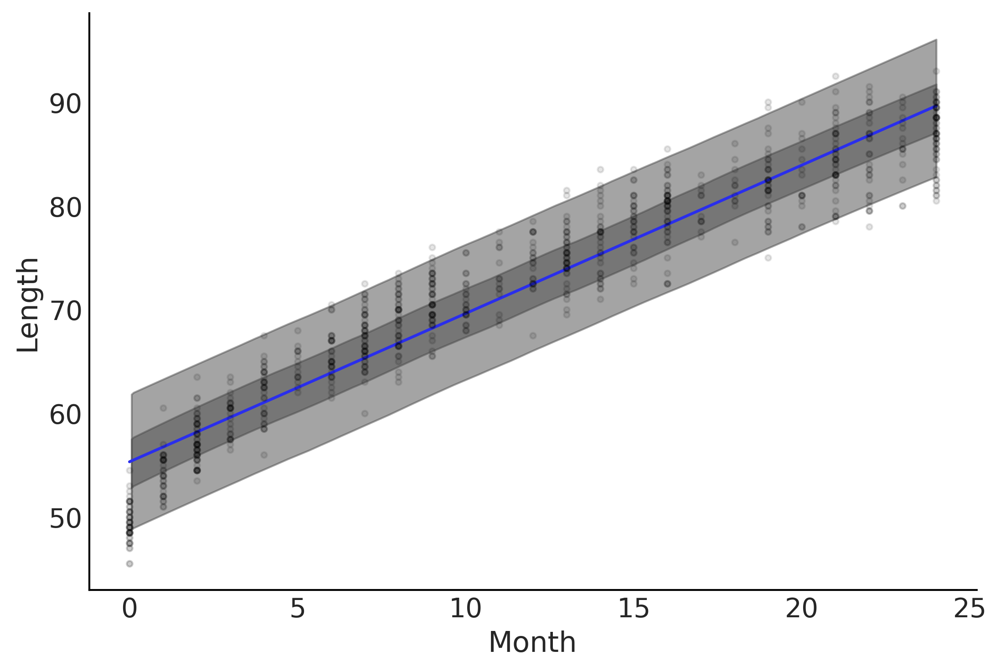

In [6]:
fig, ax = plt.subplots()

ax.set_ylabel("Length")
ax.set_xlabel("Month");

μ_m = inf_data_linear.posterior["μ"].values.reshape(-1, babies["Length"].shape[0]).mean(axis=0)

ax.plot(babies["Month"], μ_m, c='C4')
az.plot_hdi(babies["Month"], inf_data_linear.posterior_predictive["length"], hdi_prob=.50, ax=ax)
az.plot_hdi(babies["Month"], inf_data_linear.posterior_predictive["length"], hdi_prob=.94, ax=ax)

ax.plot(babies["Month"], babies["Length"], 'C0.', alpha=0.1)

plt.savefig('img/chp04/baby_length_linear_fit.png', dpi=300)

In [7]:
az.loo(inf_data_linear)

Computed from 8000 by 800 log-likelihood matrix

         Estimate       SE
elpd_loo -2133.31    18.59
p_loo        3.21        -

### Code 4.3

In [8]:
with pm.Model() as model_baby_sqrt:
    β = pm.Normal("β", sigma=10, shape=2)

    μ = pm.Deterministic("μ", β[0] + β[1] * np.sqrt(babies["Month"]))
    σ = pm.HalfNormal("σ", sigma=10)

    length = pm.Normal("length", mu=μ, sigma=σ, observed=babies["Length"])
    inf_data_sqrt = pm.sample(draws=2000, tune=4000)

    ppc_baby_sqrt = pm.sample_posterior_predictive(inf_data_sqrt)
    inf_data_sqrt = az.from_pymc3(trace=inf_data_sqrt,
                                  posterior_predictive=ppc_baby_sqrt)

/tmp/ipykernel_19/10393769.py:8: FutureWarning: In v4.0, pm.sample will return an `arviz.InferenceData` object instead of a `MultiTrace` by default. You can pass return_inferencedata=True or return_inferencedata=False to be safe and silence this warning.
  inf_data_sqrt = pm.sample(draws=2000, tune=4000)
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [σ, β]


Sampling 4 chains for 4_000 tune and 2_000 draw iterations (16_000 + 8_000 draws total) took 6 seconds.


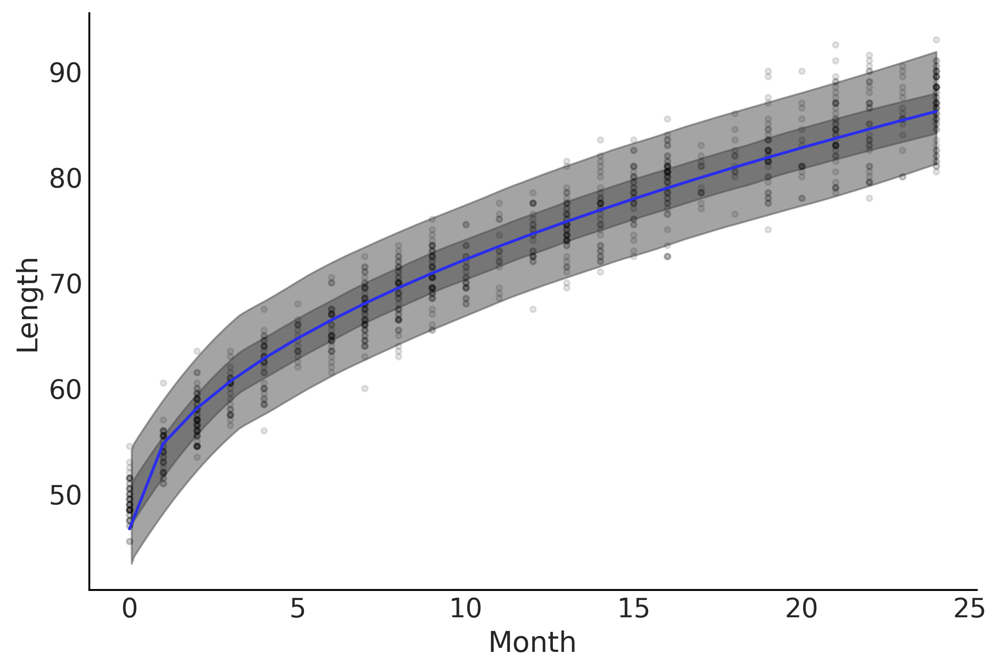

In [9]:
fig, ax = plt.subplots()

ax.plot(babies["Month"], babies["Length"], 'C0.', alpha=0.1)

ax.set_ylabel("Length")
ax.set_xlabel("Month");

μ_m = inf_data_sqrt.posterior["μ"].values.reshape(-1, babies["Length"].shape[0]).mean(axis=0)

az.plot_hdi(babies["Month"], inf_data_sqrt.posterior_predictive["length"], hdi_prob=.50, ax=ax)
az.plot_hdi(babies["Month"], inf_data_sqrt.posterior_predictive["length"], hdi_prob=.94, ax=ax)

ax.plot(babies["Month"], μ_m, c='C4')

plt.savefig('img/chp04/baby_length_sqrt_fit.png', dpi=300)

### Figure 4.3

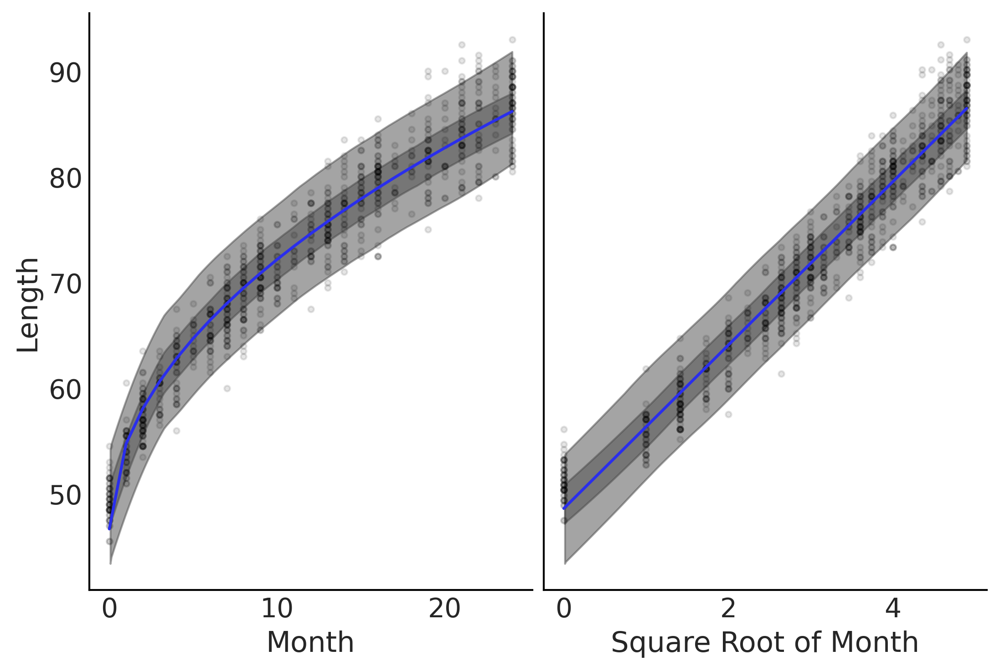

In [10]:
fig, axes = plt.subplots(1,2)
axes[0].plot(babies["Month"], babies["Length"], 'C0.', alpha=0.1)

μ_m = inf_data_sqrt.posterior["μ"].values.reshape(-1, babies["Length"].shape[0]).mean(axis=0)

axes[0].plot(babies["Month"], μ_m, c='C4')
az.plot_hdi(babies["Month"], inf_data_sqrt.posterior_predictive["length"], hdi_prob=.50, ax=axes[0])
az.plot_hdi(babies["Month"], inf_data_sqrt.posterior_predictive["length"], hdi_prob=.94, ax=axes[0])

axes[0].set_ylabel("Length")
axes[0].set_xlabel("Month");

axes[1].plot(np.sqrt(babies["Month"]), babies["Length"], 'C0.', alpha=0.1)
axes[1].set_xlabel("Square Root of Month");

az.plot_hdi(np.sqrt(babies["Month"]), inf_data_sqrt.posterior_predictive["length"], hdi_prob=.50, ax=axes[1])
az.plot_hdi(np.sqrt(babies["Month"]), inf_data_sqrt.posterior_predictive["length"], hdi_prob=.94, ax=axes[1])
axes[1].plot(np.sqrt(babies["Month"]), μ_m, c='C4')

axes[1].set_yticks([])
axes[1]

plt.savefig('img/chp04/baby_length_sqrt_fit.png', dpi=300)

In [11]:
az.compare({"Linear Model":inf_data_linear, "Non Linear Model":inf_data_sqrt})

/usr/local/lib/python3.8/dist-packages/arviz/stats/stats.py:145: UserWarning: The default method used to estimate the weights for each model,has changed from BB-pseudo-BMA to stacking
  warnings.warn(


,rank,loo,p_loo,d_loo,weight,se,dse,warning,loo_scale
Non Linear Model,0,-1968.248374,3.113173,0.000000,0.928907,18.970558,0.000000,False,log
Linear Model,1,-2133.313450,3.211344,165.065076,0.071093,18.585676,20.073485,False,log


## Varying Uncertainty

### Code 4.4

In [12]:
with pm.Model() as model_baby_vv:
    β = pm.Normal("β", sigma=10, shape=2)

    # Additional variance terms
    δ = pm.HalfNormal("δ", sigma=10, shape=2)

    μ = pm.Deterministic("μ", β[0] + β[1] * np.sqrt(babies["Month"]))
    σ = pm.Deterministic("σ", δ[0] + δ[1] * babies["Month"])

    length = pm.Normal("length", mu=μ, sigma=σ, observed=babies["Length"])

    trace_baby_vv = pm.sample(2000, target_accept=.95)
    ppc_baby_vv = pm.sample_posterior_predictive(trace_baby_vv,
                                                 var_names=["length", "σ"])
    inf_data_baby_vv = az.from_pymc3(trace=trace_baby_vv,
                                     posterior_predictive=ppc_baby_vv)

/tmp/ipykernel_19/3470835175.py:12: FutureWarning: In v4.0, pm.sample will return an `arviz.InferenceData` object instead of a `MultiTrace` by default. You can pass return_inferencedata=True or return_inferencedata=False to be safe and silence this warning.
  trace_baby_vv = pm.sample(2000, target_accept=.95)
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [δ, β]


Sampling 4 chains for 1_000 tune and 2_000 draw iterations (4_000 + 8_000 draws total) took 6 seconds.


In [13]:
az.summary(inf_data_baby_vv, var_names=["δ"])

,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_bulk,ess_tail,r_hat
δ[0],2.388,0.116,2.166,2.604,0.002,0.001,3222.0,3845.0,1.0
δ[1],0.038,0.009,0.020,0.054,0.000,0.000,3147.0,2706.0,1.0


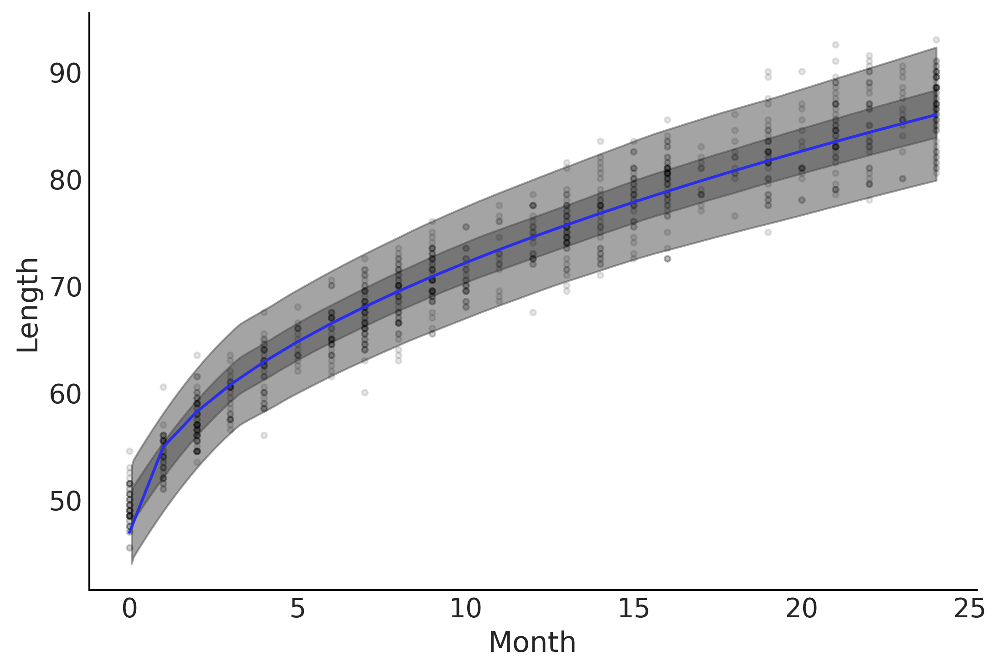

In [14]:
fig, ax = plt.subplots()

ax.set_ylabel("Length")
ax.set_xlabel("Month");

ax.plot(babies["Month"], babies["Length"], 'C0.', alpha=0.1)

μ_m = inf_data_baby_vv.posterior["μ"].values.reshape(-1, babies["Length"].shape[0]).mean(axis=0)

ax.plot(babies["Month"], μ_m, c='C4')

az.plot_hdi(babies["Month"], inf_data_baby_vv.posterior_predictive["length"], hdi_prob=.50, ax=ax)
az.plot_hdi(babies["Month"], inf_data_baby_vv.posterior_predictive["length"], hdi_prob=.94, ax=ax)

plt.savefig('img/chp04/baby_length_sqrt_vv_fit.png', dpi=300)

### Figure 4.4

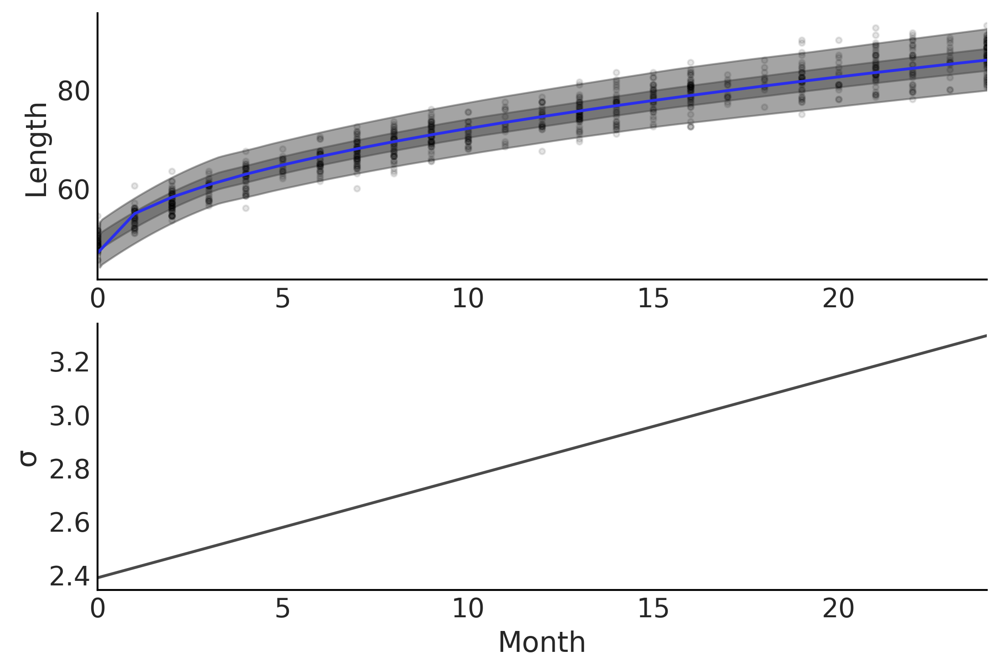

In [15]:
fig, axes = plt.subplots(2,1)

axes[0].plot(babies["Month"], babies["Length"], 'C0.', alpha=0.1)

μ_m = inf_data_baby_vv.posterior["μ"].values.reshape(-1, babies["Length"].shape[0]).mean(axis=0)

axes[0].plot(babies["Month"], μ_m, c='C4')

az.plot_hdi(babies["Month"], inf_data_baby_vv.posterior_predictive["length"], hdi_prob=.50, ax=axes[0])
az.plot_hdi(babies["Month"], inf_data_baby_vv.posterior_predictive["length"], hdi_prob=.94, ax=axes[0])
axes[0].set_ylabel("Length")

σ_m = inf_data_baby_vv.posterior["σ"].values.reshape(-1, 800).mean(axis=0)

axes[1].plot(babies["Month"], σ_m, c='C1')

axes[1].set_ylabel("σ")
axes[1].set_xlabel("Month")

axes[0].set_xlim(0,24)
axes[1].set_xlim(0,24)

plt.savefig('img/chp04/baby_length_sqrt_vv_fit_include_error.png', dpi=300)

## Interaction effects

### Code 4.5

In [16]:
tips_df = pd.read_csv('../data/tips.csv')
tips_df.head()

,total_bill,tip,sex,smoker,day,time,size
0,16.99,1.01,Female,No,Sun,Dinner,2
1,10.34,1.66,Male,No,Sun,Dinner,3
2,21.01,3.50,Male,No,Sun,Dinner,3
3,23.68,3.31,Male,No,Sun,Dinner,2
4,24.59,3.61,Female,No,Sun,Dinner,4


In [17]:
tips = tips_df["tip"]
total_bill_c = (tips_df["total_bill"] - tips_df["total_bill"].mean())  
smoker = pd.Categorical(tips_df["smoker"]).codes

with pm.Model() as model_no_interaction:
    β = pm.Normal("β", mu=0, sigma=1, shape=3)
    σ = pm.HalfNormal("σ", 1)

    μ = (β[0] +
         β[1] * total_bill_c + 
         β[2] * smoker)

    obs = pm.Normal("obs", μ, σ, observed=tips)
    trace_no_interaction = pm.sample(1000, tune=1000)

/tmp/ipykernel_19/791082598.py:14: FutureWarning: In v4.0, pm.sample will return an `arviz.InferenceData` object instead of a `MultiTrace` by default. You can pass return_inferencedata=True or return_inferencedata=False to be safe and silence this warning.
  trace_no_interaction = pm.sample(1000, tune=1000)
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [σ, β]


Sampling 4 chains for 1_000 tune and 1_000 draw iterations (4_000 + 4_000 draws total) took 2 seconds.


/tmp/ipykernel_19/2274639647.py:7: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  pred_y_non_smokers = β0_nonint + β1_nonint * total_bill_c[:,None]
/tmp/ipykernel_19/2274639647.py:8: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  pred_y_smokers = β0_nonint + β1_nonint * total_bill_c[:,None] + β2_nonint


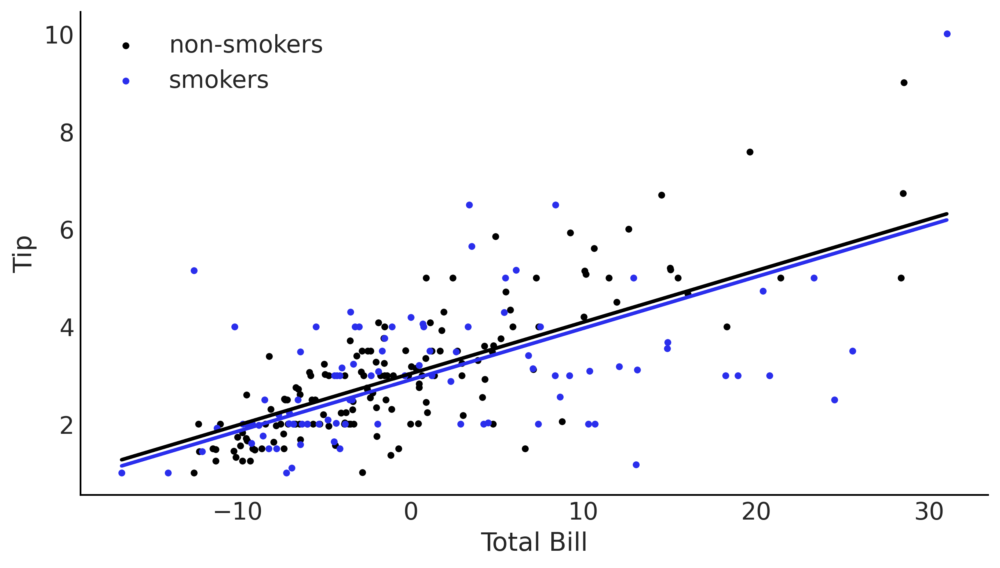

In [18]:
_, ax = plt.subplots(figsize=(8, 4.5))

β0_nonint = trace_no_interaction['β'][:,0]
β1_nonint = trace_no_interaction['β'][:,1]
β2_nonint = trace_no_interaction['β'][:,2]

pred_y_non_smokers = β0_nonint + β1_nonint * total_bill_c[:,None]
pred_y_smokers = β0_nonint + β1_nonint * total_bill_c[:,None] + β2_nonint

ax.scatter(total_bill_c[smoker==0], tips[smoker==0], label='non-smokers', marker='.')
ax.scatter(total_bill_c[smoker==1], tips[smoker==1], label='smokers', marker='.', c="C4")
ax.set_xlabel('Total Bill')
ax.set_ylabel('Tip')
ax.legend()

ax.plot(total_bill_c, pred_y_non_smokers.mean(1), lw=2)
ax.plot(total_bill_c, pred_y_smokers.mean(1), lw=2, c="C4");

### Code 4.6

In [19]:
with pm.Model() as model_interaction:
    β = pm.Normal('β', mu=0, sigma=1, shape=4)
    σ = pm.HalfNormal('σ', 1)

    μ = (β[0] +
         β[1] * total_bill_c + 
         β[2] * smoker +
         β[3] * smoker * total_bill_c
        )

    obs = pm.Normal('obs', μ, σ, observed=tips)
    trace_interaction = pm.sample(1000, tune=1000)

/tmp/ipykernel_19/196331178.py:12: FutureWarning: In v4.0, pm.sample will return an `arviz.InferenceData` object instead of a `MultiTrace` by default. You can pass return_inferencedata=True or return_inferencedata=False to be safe and silence this warning.
  trace_interaction = pm.sample(1000, tune=1000)
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [σ, β]


Sampling 4 chains for 1_000 tune and 1_000 draw iterations (4_000 + 4_000 draws total) took 2 seconds.


### Figure 4.5

/usr/local/lib/python3.8/dist-packages/arviz/stats/stats.py:456: FutureWarning: hdi currently interprets 2d data as (draw, shape) but this will change in a future release to (chain, draw) for coherence with other functions
  warnings.warn(
/usr/local/lib/python3.8/dist-packages/arviz/stats/stats.py:456: FutureWarning: hdi currently interprets 2d data as (draw, shape) but this will change in a future release to (chain, draw) for coherence with other functions
  warnings.warn(
/usr/local/lib/python3.8/dist-packages/arviz/stats/stats.py:456: FutureWarning: hdi currently interprets 2d data as (draw, shape) but this will change in a future release to (chain, draw) for coherence with other functions
  warnings.warn(
/usr/local/lib/python3.8/dist-packages/arviz/stats/stats.py:456: FutureWarning: hdi currently interprets 2d data as (draw, shape) but this will change in a future release to (chain, draw) for coherence with other functions
  warnings.warn(


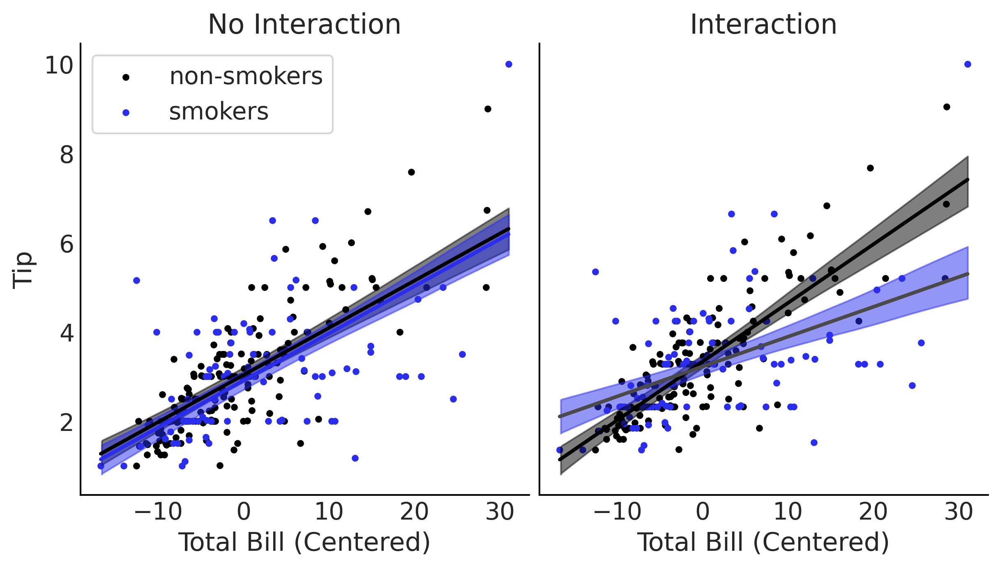

In [20]:
total_bill_c = total_bill_c.values

_, ax = plt.subplots(1, 2, figsize=(8, 4.5))

#α_nonint = trace_nonint['α']

β0_nonint = trace_no_interaction['β'][:,0]
β1_nonint = trace_no_interaction['β'][:,1]
β2_nonint = trace_no_interaction['β'][:,2]


pred_y_non_smokers = β0_nonint + β1_nonint * total_bill_c[:,None]
pred_y_smokers = β0_nonint + β1_nonint * total_bill_c[:,None] + β2_nonint

ax[0].scatter(total_bill_c[smoker==0], tips[smoker==0], label='non-smokers', marker='.')
ax[0].scatter(total_bill_c[smoker==1], tips[smoker==1], label='smokers', marker='.', c="C4")
ax[0].set_xlabel('Total Bill (Centered)')
ax[0].set_ylabel('Tip')
ax[0].legend(frameon=True)

ax[0].plot(total_bill_c, pred_y_non_smokers.mean(1), lw=2)
ax[0].plot(total_bill_c, pred_y_smokers.mean(1), lw=2, c="C4")
ax[0].set_title('No Interaction')


az.plot_hdi(total_bill_c, pred_y_non_smokers.T, color='C0', ax=ax[0])
az.plot_hdi(total_bill_c, pred_y_smokers.T, ax=ax[0], color="C4");

β0_int = trace_interaction['β'][:,0]
β1_int = trace_interaction['β'][:,1]
β2_int = trace_interaction['β'][:,2]
β3_int = trace_interaction['β'][:,3]

# Because smoker=0 I am ommiting the terms including the smoker covariate
pred_y_non_smokers = (β0_int +
                      β1_int * total_bill_c[:, None])

# Because x1=1 I am ommiting x1
pred_y_smokers = (β0_int +
                  β1_int * total_bill_c[:, None] +
                  β2_int +
                  β3_int * total_bill_c[:, None])


ax[1].scatter(total_bill_c[smoker==0], tips[smoker==0], label='non-smokers', marker='.')
ax[1].scatter(total_bill_c[smoker==1], tips[smoker==1], label='smokers', marker='.', c="C4")
ax[1].set_xlabel('Total Bill (Centered)')
ax[1].set_yticks([])

ax[1].set_title('Interaction')

ax[1].plot(total_bill_c, pred_y_non_smokers.mean(1), lw=2)
ax[1].plot(total_bill_c, pred_y_smokers.mean(1), lw=2)
az.plot_hdi(total_bill_c, pred_y_non_smokers.T, color='C0', ax=ax[1])
az.plot_hdi(total_bill_c, pred_y_smokers.T, ax=ax[1], color="C4");

plt.savefig('img/chp04/smoker_tip_interaction.png', dpi=300)

## Robust Regression

### Figure 4.6

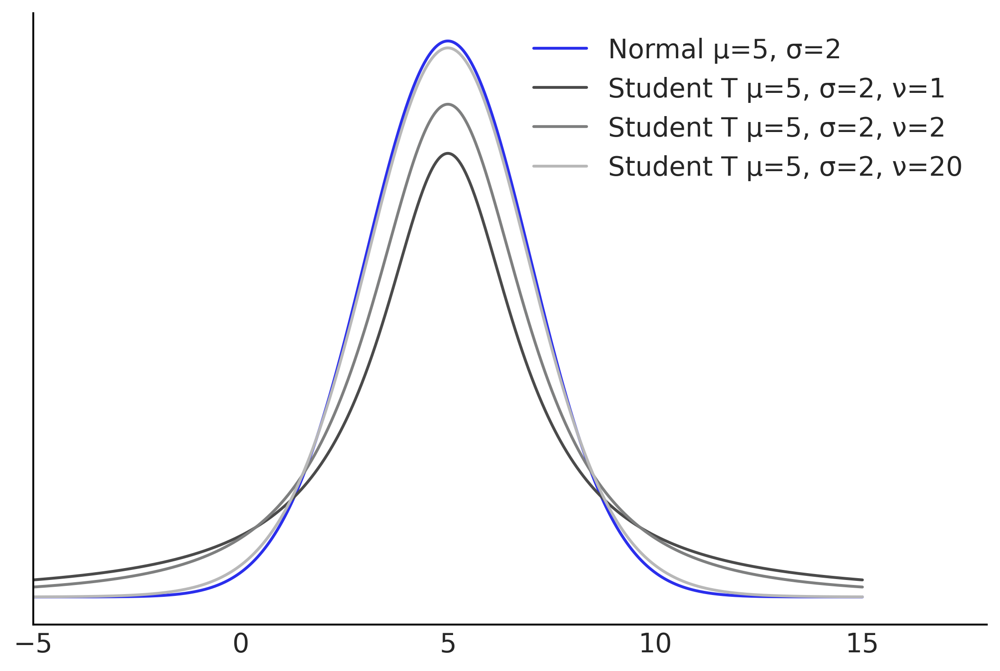

In [21]:
mean = 5
sigma = 2

x = np.linspace(-5, 15, 1000)
fig, ax = plt.subplots()

ax.plot(x, stats.norm(5,2).pdf(x), label=f"Normal μ={mean}, σ={sigma}", color="C4")

for i, nu in enumerate([1, 2, 20],1):
    ax.plot(x, stats.t(loc=5, scale=2, df=nu).pdf(x), label=f"Student T μ={mean}, σ={sigma}, ν={nu}", color=f"C{i}")

ax.set_xlim(-5, 18)
ax.legend(loc="upper right", frameon=False)
ax.set_yticks([])
plt.savefig('img/chp04/studentt_normal_comparison.png', dpi=300)

### Figure 4.7

In [22]:
def generate_sales(*, days, mean, std, label):
    np.random.seed(0)
    df = pd.DataFrame(index=range(1, days+1), columns=["customers", "sales"])
    for day in range(1, days+1):
        num_customers = stats.randint(30, 100).rvs()+1
        
        # This is correct as there is an independent draw for each customers orders
        dollar_sales = stats.norm(mean, std).rvs(num_customers).sum()
        
        df.loc[day, "customers"] = num_customers
        df.loc[day, "sales"] = dollar_sales
        
    # Fix the types as not to cause Theano errors
    df = df.astype({'customers': 'int32', 'sales': 'float32'})
    
    # Sorting will make plotting the posterior predictive easier later
    df["Food_Category"] = label
    df = df.sort_values("customers")
    return df


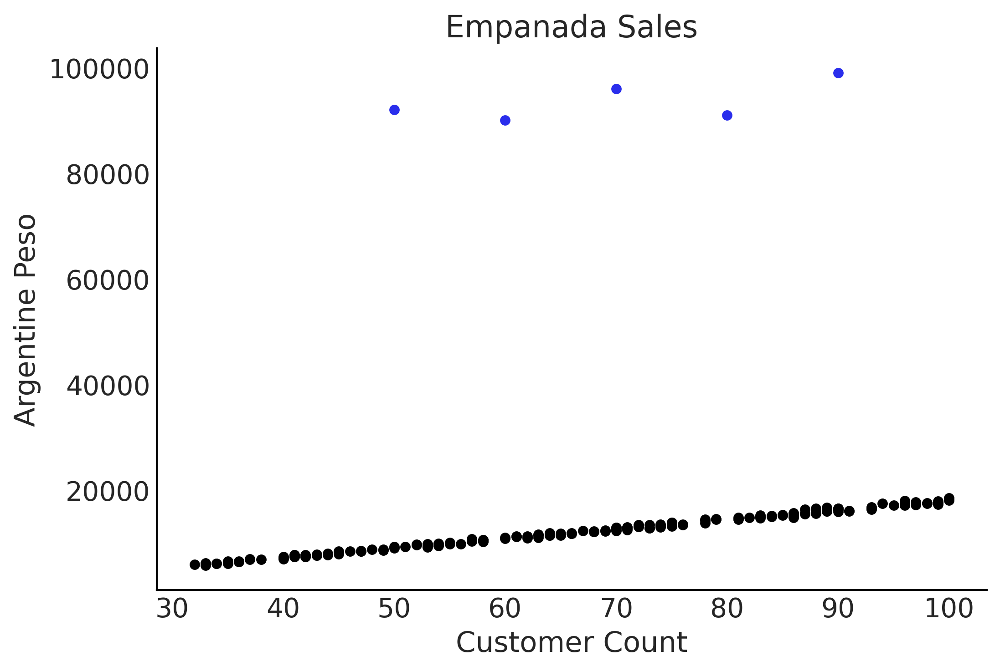

In [23]:
fig, ax = plt.subplots()

empanadas =  generate_sales(days=200, mean=180, std=30, label="Empanada")
empanadas.iloc[0] = [50, 92000, "Empanada"]
empanadas.iloc[1] = [60, 90000, "Empanada"]
empanadas.iloc[2] = [70, 96000, "Empanada"]
empanadas.iloc[3] = [80, 91000, "Empanada"]
empanadas.iloc[4] = [90, 99000, "Empanada"]

empanadas = empanadas.sort_values("customers")

empanadas.sort_values("sales")[:-5].plot(x="customers", y="sales", kind="scatter", ax=ax);
empanadas.sort_values("sales")[-5:].plot(x="customers", y="sales", kind="scatter", c="C4", ax=ax);

ax.set_ylabel("Argentine Peso")
ax.set_xlabel("Customer Count")
ax.set_title("Empanada Sales")
plt.savefig('img/chp04/empanada_scatter_plot.png', dpi=300)

### Code 4.7

In [24]:
with pm.Model() as model_non_robust:
    σ = pm.HalfNormal("σ", 50)
    β = pm.Normal('β', mu=150, sigma=20)

    μ = pm.Deterministic("μ", β * empanadas["customers"])
    
    sales = pm.Normal("sales", mu=μ, sigma=σ, observed=empanadas["sales"])
    
    trace_empanada_sales = pm.sample(random_seed=1)
    ppc_empanada_sales = pm.sample_posterior_predictive(
        trace_empanada_sales)
    inf_data_non_robust = az.from_pymc3(trace = trace_empanada_sales,
                                        posterior_predictive=ppc_empanada_sales)

/tmp/ipykernel_19/3284257218.py:9: FutureWarning: In v4.0, pm.sample will return an `arviz.InferenceData` object instead of a `MultiTrace` by default. You can pass return_inferencedata=True or return_inferencedata=False to be safe and silence this warning.
  trace_empanada_sales = pm.sample(random_seed=1)
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [β, σ]


Sampling 4 chains for 1_000 tune and 1_000 draw iterations (4_000 + 4_000 draws total) took 5 seconds.
The acceptance probability does not match the target. It is 0.8858516058990968, but should be close to 0.8. Try to increase the number of tuning steps.


### Figure 4.8

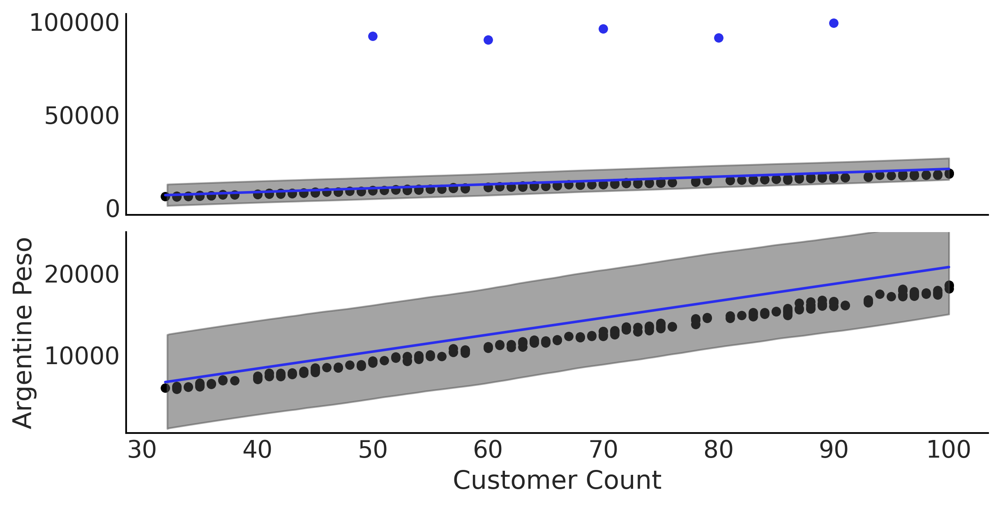

In [25]:
fig, axes = plt.subplots(2, 1, figsize=(8, 4), sharex=True)
μ_m = inf_data_non_robust.posterior["μ"].values.reshape(-1, empanadas.shape[0]).mean(axis=0)

for i in range(2):
    empanadas.sort_values("sales")[:-5].plot(x="customers", y="sales", kind="scatter", ax=axes[i]);
    empanadas.sort_values("sales")[-5:].plot(x="customers", y="sales", kind="scatter", c="C4", ax=axes[i]);
    axes[i].plot(empanadas.customers, μ_m, c='C4')
    az.plot_hdi(empanadas.customers, inf_data_non_robust.posterior_predictive["sales"], hdi_prob=.95, ax=axes[i])

    axes[1].set_ylabel("Argentine Peso")

axes[0].set_ylabel("")
axes[1].set_xlabel("Customer Count")
axes[1].set_ylim(400, 25000);
plt.savefig('img/chp04/empanada_scatter_non_robust.png', dpi=300)

### Table 4.1

In [26]:
az.summary(inf_data_non_robust, kind="stats", var_names=["β", "σ"]).round(1)

,mean,sd,hdi_3%,hdi_97%
β,207.0,2.9,201.4,212.4
σ,2951.0,24.5,2905.1,2996.6


In [27]:
with pm.Model() as model_robust:
    σ = pm.HalfNormal("σ", 50)
    β = pm.Normal("β", mu=150, sigma=20)
    ν = pm.HalfNormal("ν", 20)

    μ = pm.Deterministic("μ", β * empanadas["customers"])
    
    sales = pm.StudentT("sales", mu=μ, sigma=σ, nu=ν,
                        observed=empanadas["sales"])
        
    trace_empanada_sales_robust = pm.sample(random_seed=0)
    ppc_empanada_sales_robust = pm.sample_posterior_predictive(
                                        trace_empanada_sales_robust)
    
    inf_data_robust = az.from_pymc3(trace = trace_empanada_sales_robust,
                                    posterior_predictive=ppc_empanada_sales_robust)

/tmp/ipykernel_19/4170216013.py:11: FutureWarning: In v4.0, pm.sample will return an `arviz.InferenceData` object instead of a `MultiTrace` by default. You can pass return_inferencedata=True or return_inferencedata=False to be safe and silence this warning.
  trace_empanada_sales_robust = pm.sample(random_seed=0)
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [ν, β, σ]


Sampling 4 chains for 1_000 tune and 1_000 draw iterations (4_000 + 4_000 draws total) took 1 seconds.


### Table 4.2

In [28]:
az.summary(inf_data_robust, var_names=["β", "σ", "ν"], kind="stats").round(1)

,mean,sd,hdi_3%,hdi_97%
β,179.6,0.3,179.2,180.1
σ,152.0,13.5,127.1,177.1
ν,1.3,0.2,1.0,1.6


### Figure 4.9

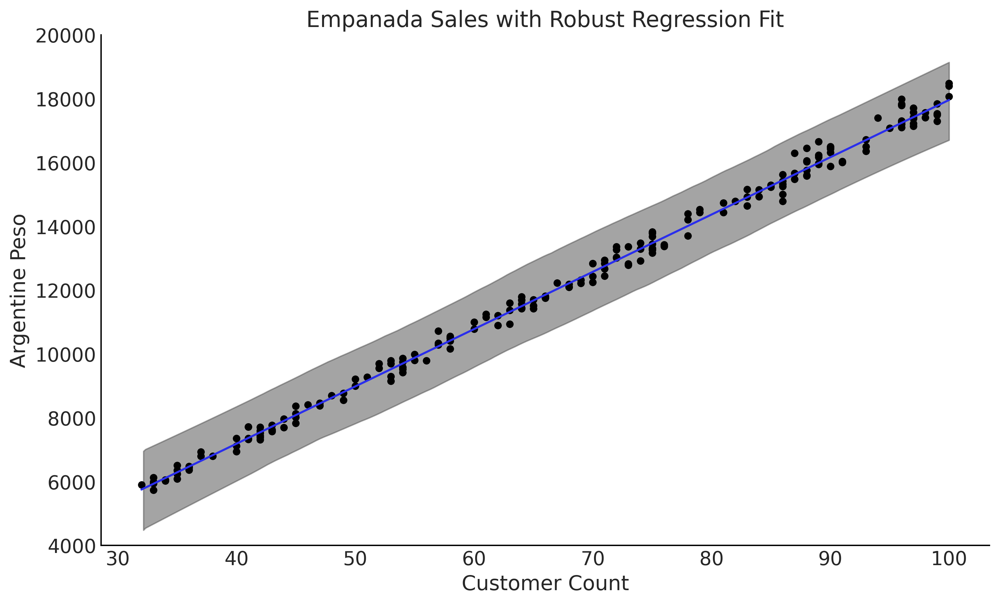

In [29]:
fig, ax = plt.subplots(figsize=(10, 6))
μ_m = inf_data_robust.posterior["μ"].values.reshape(-1, empanadas.shape[0]).mean(axis=0)

ax.plot(empanadas.customers, μ_m, c='C4')
az.plot_hdi(empanadas.customers, inf_data_robust.posterior_predictive["sales"], hdi_prob=.95, ax=ax)

empanadas.plot(x="customers", y="sales", kind="scatter", ax=ax)
ax.set_ylim(4000, 20000);
ax.set_ylabel("Argentine Peso")
ax.set_xlabel("Customer Count")
ax.set_title("Empanada Sales with Robust Regression Fit")
plt.savefig('img/chp04/empanada_scatter_robust.png', dpi=300)

In [30]:
az.compare({"Non robust": inf_data_non_robust, "Robust":inf_data_robust})

/usr/local/lib/python3.8/dist-packages/arviz/stats/stats.py:145: UserWarning: The default method used to estimate the weights for each model,has changed from BB-pseudo-BMA to stacking
  warnings.warn(
/usr/local/lib/python3.8/dist-packages/arviz/stats/stats.py:655: UserWarning: Estimated shape parameter of Pareto distribution is greater than 0.7 for one or more samples. You should consider using a more robust model, this is because importance sampling is less likely to work well if the marginal posterior and LOO posterior are very different. This is more likely to happen with a non-robust model and highly influential observations.
  warnings.warn(


,rank,loo,p_loo,d_loo,weight,se,dse,warning,loo_scale
Robust,0,-1473.698879,5.595766,0.000000,1.000000e+00,31.836904,0.000000,False,log
Non robust,1,-3702.674390,150.115383,2228.975512,6.439294e-15,831.114070,801.434839,True,log


## Pooling, Multilevel Models, and Mixed Effects

In [31]:
def generate_sales(*, days, mean, std, label):
    np.random.seed(0)
    df = pd.DataFrame(index=range(1, days+1), columns=["customers", "sales"])
    for day in range(1, days+1):
        num_customers = stats.randint(30, 100).rvs()+1
        
        # This is correct as there is an independent draw for each customers orders
        dollar_sales = stats.norm(mean, std).rvs(num_customers).sum()
        
        df.loc[day, "customers"] = num_customers
        df.loc[day, "sales"] = dollar_sales
        
    # Fix the types as not to cause Theano errors
    df = df.astype({'customers': 'int32', 'sales': 'float32'})
    
    # Sorting will make plotting the posterior predictive easier later
    df["Food_Category"] = label
    df = df.sort_values("customers")
    return df


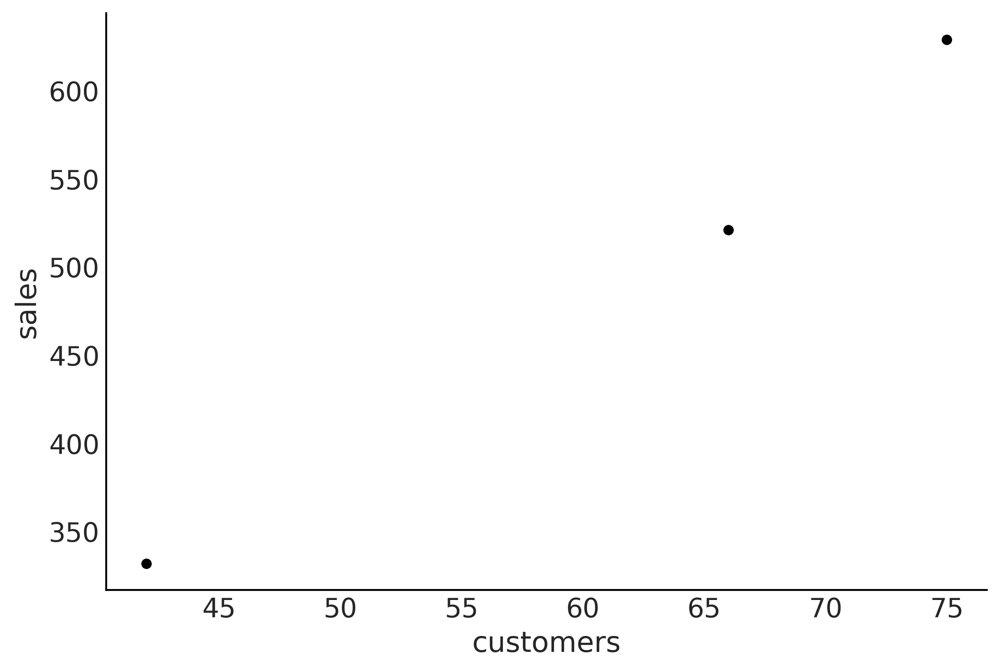

In [32]:
pizza_df = generate_sales(days=365, mean=13, std=5, label="Pizza")
sandwich_df = generate_sales(days=100, mean=6, std=5, label="Sandwich")

salad_days = 3
salad_df = generate_sales(days=salad_days, mean=8 ,std=3, label="Salad")

salad_df.plot(x="customers", y="sales", kind="scatter");

In [33]:
sales_df = pd.concat([pizza_df, sandwich_df, salad_df]).reset_index(drop=True)
sales_df["Food_Category"] = pd.Categorical(sales_df["Food_Category"])
sales_df

,customers,sales,Food_Category
0,31,459.895203,Pizza
1,31,401.147736,Pizza
2,31,413.345245,Pizza
3,31,371.909241,Pizza
4,32,433.797089,Pizza
...,...,...,...
463,100,611.736816,Sandwich
464,100,667.152954,Sandwich
465,42,331.625702,Salad
466,66,520.900940,Salad


### Figure 4.10

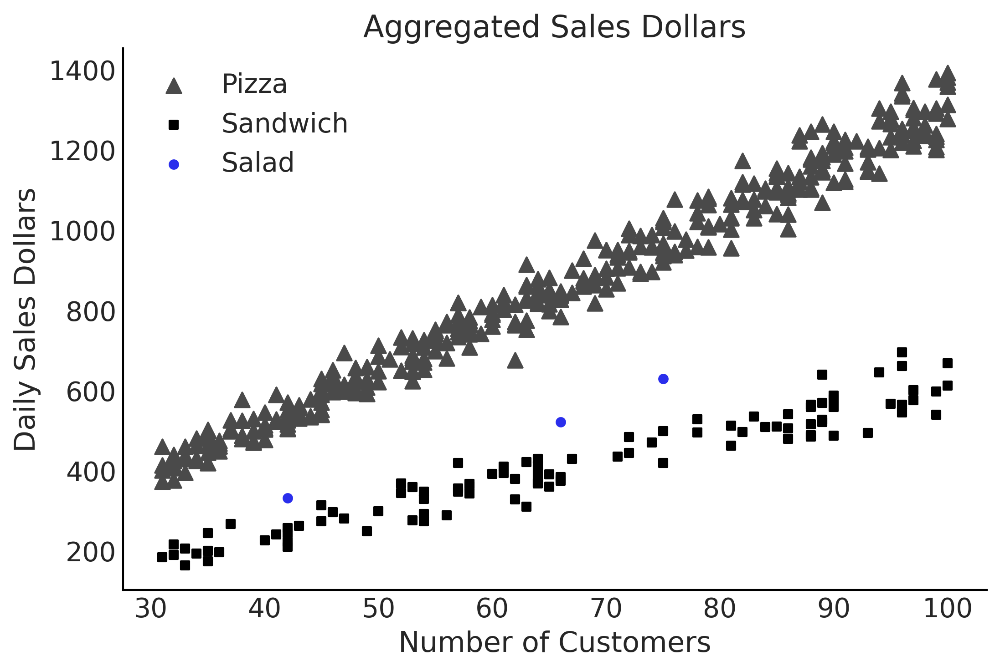

In [34]:
fig, ax = plt.subplots()
pizza_df.plot(x="customers", y="sales", kind="scatter", ax=ax, c="C1", label="Pizza", marker="^", s=60);
sandwich_df.plot(x="customers", y="sales", kind="scatter", ax=ax,  label="Sandwich", marker="s");
salad_df.plot(x="customers", y="sales", kind="scatter", ax=ax, label="Salad", c="C4");

ax.set_xlabel("Number of Customers")
ax.set_ylabel("Daily Sales Dollars")
ax.set_title("Aggregated Sales Dollars")
ax.legend()

plt.savefig('img/chp04/restaurant_order_scatter.png', dpi=300)

### Unpooled Model

### Code 4.9

In [35]:
customers = sales_df.loc[:, "customers"].values
sales_observed = sales_df.loc[:, "sales"].values
food_category = pd.Categorical(sales_df["Food_Category"])

with pm.Model() as model_sales_unpooled:
    σ = pm.HalfNormal("σ", 20, shape=3)
    β = pm.Normal("β", mu=10, sigma=10, shape=3)
    
    μ = pm.Deterministic("μ", β[food_category.codes] *customers)
    
    sales = pm.Normal("sales", mu=μ, sigma=σ[food_category.codes],
                      observed=sales_observed)
    
    trace_sales_unpooled = pm.sample(target_accept=.9)
    inf_data_sales_unpooled = az.from_pymc3(
        trace=trace_sales_unpooled, 
        coords={"β_dim_0":food_category.categories,
                "σ_dim_0":food_category.categories})

/tmp/ipykernel_19/112331439.py:14: FutureWarning: In v4.0, pm.sample will return an `arviz.InferenceData` object instead of a `MultiTrace` by default. You can pass return_inferencedata=True or return_inferencedata=False to be safe and silence this warning.
  trace_sales_unpooled = pm.sample(target_accept=.9)
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [β, σ]


Sampling 4 chains for 1_000 tune and 1_000 draw iterations (4_000 + 4_000 draws total) took 3 seconds.


### Figure 4.12

In [36]:
inf_data_salads_sales_unpooled = inf_data_sales_unpooled.posterior.sel(β_dim_0="Salad", μ_dim_0=slice(465, 467))

In [37]:
az.summary(inf_data_sales_unpooled, var_names=["β", "σ"])

,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_bulk,ess_tail,r_hat
β[0],13.024,0.030,12.967,13.079,0.000,0.000,4545.0,2784.0,1.0
β[1],8.131,0.205,7.734,8.528,0.004,0.003,3039.0,2272.0,1.0
β[2],6.114,0.052,6.016,6.213,0.001,0.000,5768.0,3064.0,1.0
σ[0],40.140,1.458,37.412,42.897,0.020,0.014,5419.0,3107.0,1.0
σ[1],21.219,8.262,8.959,36.741,0.154,0.113,3294.0,2733.0,1.0
σ[2],35.935,2.455,31.504,40.546,0.034,0.024,5068.0,2911.0,1.0


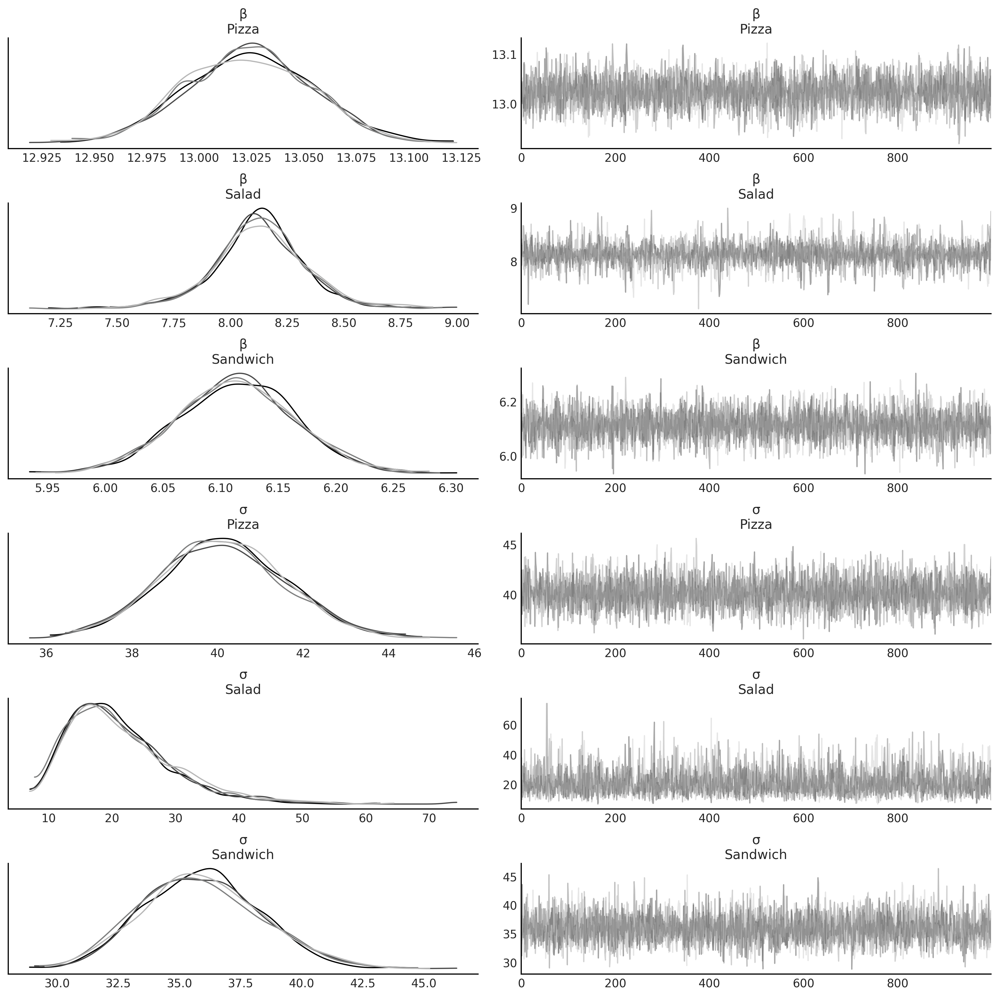

In [38]:
az.plot_trace(inf_data_sales_unpooled, var_names=["β", "σ"], compact=False);

### Figure 4.13

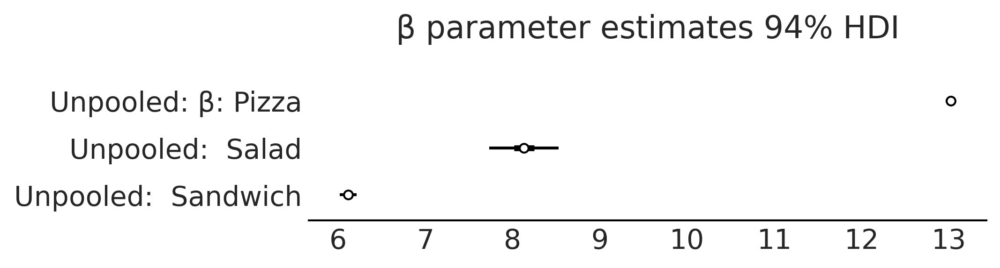

In [39]:
axes = az.plot_forest([inf_data_sales_unpooled],
                      model_names = ["Unpooled",],
                      var_names=["β"], combined=True, figsize=(7, 1.8));
axes[0].set_title("β parameter estimates 94% HDI")
plt.savefig("img/chp04/salad_sales_basic_regression_forestplot_beta.png")

### Figure 4.14

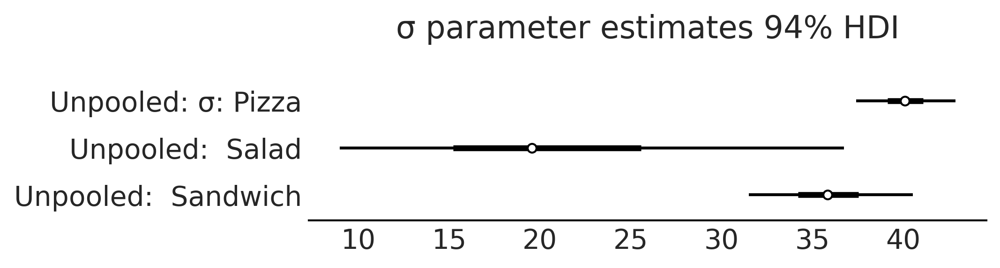

In [40]:
axes = az.plot_forest([inf_data_salads_sales_unpooled,],
                      model_names = ["Unpooled",],
                      var_names=["σ"], combined=True, figsize=(7, 1.8));
axes[0].set_title("σ parameter estimates 94% HDI")
plt.savefig("img/chp04/salad_sales_basic_regression_forestplot_sigma.png")

### Pooled Model

### Code 4.10

In [41]:
with pm.Model() as model_sales_pooled:
    σ = pm.HalfNormal("σ", 20)
    β = pm.Normal("β", mu=10, sigma=10)

    μ = pm.Deterministic("μ", β * customers)
    
    sales = pm.Normal("sales", mu=μ, sigma=σ,
                      observed=sales_observed)
                        
    inf_data_sales_pooled = pm.sample()

/tmp/ipykernel_19/1783417553.py:10: FutureWarning: In v4.0, pm.sample will return an `arviz.InferenceData` object instead of a `MultiTrace` by default. You can pass return_inferencedata=True or return_inferencedata=False to be safe and silence this warning.
  inf_data_sales_pooled = pm.sample()
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [β, σ]


Sampling 4 chains for 1_000 tune and 1_000 draw iterations (4_000 + 4_000 draws total) took 1 seconds.


In [42]:
with model_sales_pooled:
    ppc_sales_pooled = pm.sample_posterior_predictive(inf_data_sales_pooled)
    inf_data_sales_pooled = az.from_pymc3(
        trace=inf_data_sales_pooled,
        posterior_predictive=ppc_sales_pooled)

### Figure 4.16

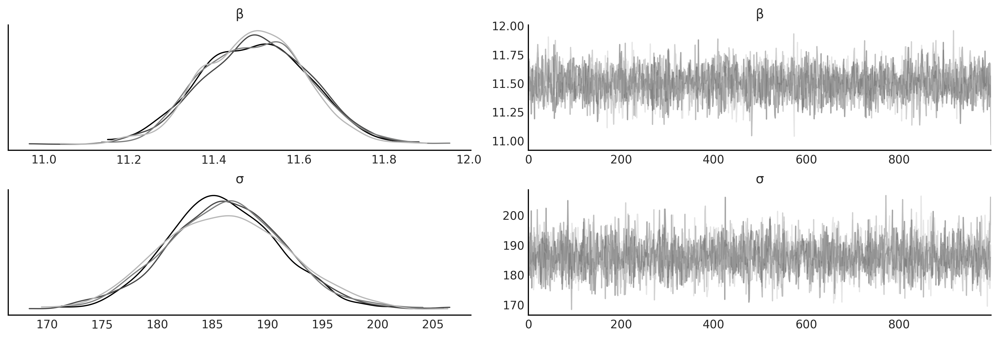

In [43]:
az.plot_trace(inf_data_sales_pooled, var_names=["β", "σ"], compact=False);

In [44]:
az.summary(inf_data_sales_pooled, var_names=["β", "σ"])

,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_bulk,ess_tail,r_hat
β,11.497,0.124,11.279,11.734,0.002,0.002,3247.0,2453.0,1.0
σ,186.175,5.364,175.915,195.910,0.089,0.063,3653.0,2793.0,1.0


### Figure 4.17

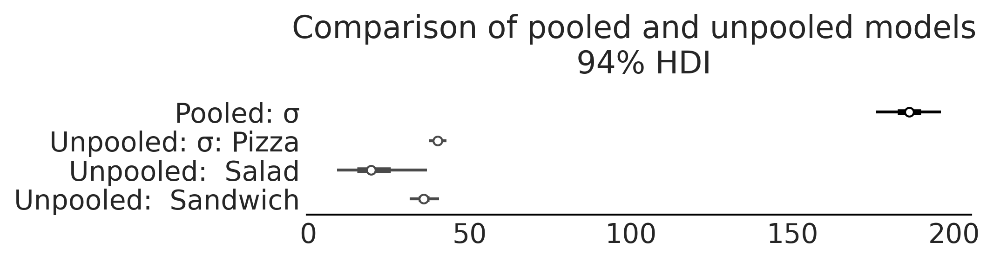

In [45]:
axes = az.plot_forest([inf_data_sales_pooled, inf_data_sales_unpooled],
                      model_names = ["Pooled", "Unpooled"], var_names=["σ"], combined=True, figsize=(7, 1.8));
axes[0].set_title("Comparison of pooled and unpooled models \n 94% HDI")

#plt.subplots_adjust(top=1)
plt.savefig("img/chp04/salad_sales_basic_regression_forestplot_sigma_comparison.png", bbox_inches='tight')

### Figure 4.18

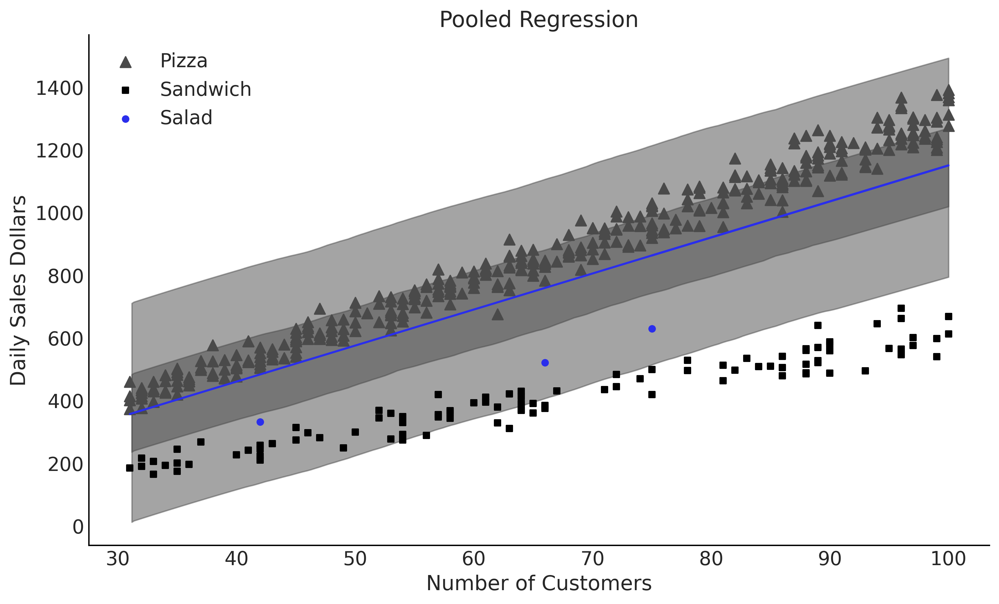

In [46]:
fig, ax = plt.subplots(figsize=(10, 6))
μ_m = inf_data_sales_pooled.posterior["μ"].values.reshape(-1, sales_df.shape[0]).mean(axis=0)
σ_m = inf_data_sales_pooled.posterior["σ"].mean().values

ax.plot(customers, μ_m, c='C4')

az.plot_hdi(customers, inf_data_sales_pooled.posterior_predictive["sales"], hdi_prob=.50, ax=ax)
az.plot_hdi(customers, inf_data_sales_pooled.posterior_predictive["sales"], hdi_prob=.94, ax=ax)


pizza_df.plot(x="customers", y="sales", kind="scatter", ax=ax, c="C1", label="Pizza", marker="^", s=60);
sandwich_df.plot(x="customers", y="sales", kind="scatter", ax=ax,  label="Sandwich", marker="s");
salad_df.plot(x="customers", y="sales", kind="scatter", ax=ax, label="Salad", c="C4");


ax.set_xlabel("Number of Customers")
ax.set_ylabel("Daily Sales Dollars")
ax.set_title("Pooled Regression")
plt.savefig("img/chp04/salad_sales_basic_regression_scatter_pooled.png")

### Code 4.11

In [47]:
with pm.Model() as model_pooled_sigma_sales:
    σ = pm.HalfNormal("σ", 20)
    β = pm.Normal("β", mu=10, sigma=20, shape=3)
    
    μ = pm.Deterministic("μ", β[food_category.codes] * customers)
    
    sales = pm.Normal("sales", mu=μ, sigma=σ, observed=sales_observed)
    
    trace_pooled_sigma_sales = pm.sample()
    ppc_pooled_sigma_sales = pm.sample_posterior_predictive(
        trace_pooled_sigma_sales)

    inf_data_pooled_sigma_sales = az.from_pymc3(
        trace=trace_pooled_sigma_sales,
        posterior_predictive=ppc_pooled_sigma_sales,
        coords={"β_dim_0":food_category.categories})

/tmp/ipykernel_19/3670165891.py:9: FutureWarning: In v4.0, pm.sample will return an `arviz.InferenceData` object instead of a `MultiTrace` by default. You can pass return_inferencedata=True or return_inferencedata=False to be safe and silence this warning.
  trace_pooled_sigma_sales = pm.sample()
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [β, σ]


Sampling 4 chains for 1_000 tune and 1_000 draw iterations (4_000 + 4_000 draws total) took 1 seconds.


In [48]:
az.summary(inf_data_pooled_sigma_sales, var_names=["β", "σ"])

,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_bulk,ess_tail,r_hat
β[0],13.025,0.030,12.965,13.079,0.000,0.000,7124.0,2923.0,1.0
β[1],8.135,0.357,7.431,8.772,0.005,0.003,6091.0,3118.0,1.0
β[2],6.113,0.056,6.010,6.220,0.001,0.000,7097.0,3218.0,1.0
σ,39.260,1.324,36.880,41.833,0.016,0.011,6805.0,3156.0,1.0


### Figure 4.20

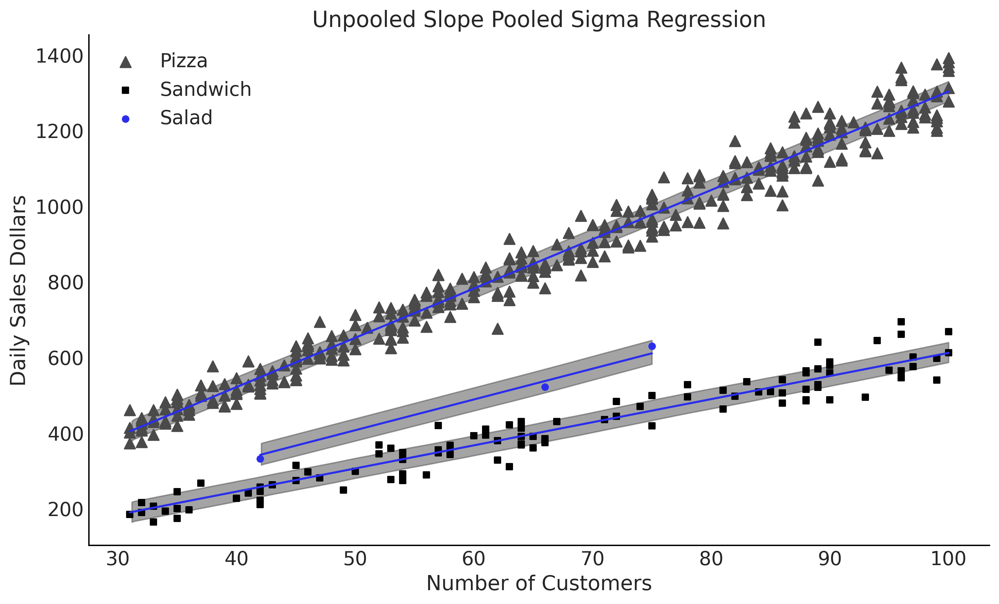

In [49]:
fig, ax = plt.subplots(figsize=(10, 6))
σ_m = inf_data_sales_pooled.posterior["σ"].mean().values

# Salads

for i in range(3):
    category_mask = (food_category.codes==i)
    μ_m_salads = inf_data_pooled_sigma_sales.posterior["μ"][:,:, category_mask].mean(axis=(0,1))
    ax.plot(sales_df.customers[category_mask], μ_m_salads, c='C4')
    az.plot_hdi(sales_df.customers[category_mask], inf_data_pooled_sigma_sales.posterior_predictive["sales"][:,:, (category_mask)], hdi_prob=.50, ax=ax, fill_kwargs={"alpha": .5})
    #az.plot_hdi(sales_df.customers[category_mask], inf_data_pooled_sigma_sales.posterior_predictive["sales"][:,:, (category_mask)], hdi_prob=.94, ax=ax)


pizza_df.plot(x="customers", y="sales", kind="scatter", ax=ax, c="C1", label="Pizza", marker="^", s=60);
sandwich_df.plot(x="customers", y="sales", kind="scatter", ax=ax,  label="Sandwich", marker="s");
salad_df.plot(x="customers", y="sales", kind="scatter", ax=ax, label="Salad", c="C4");


ax.set_xlabel("Number of Customers")
ax.set_ylabel("Daily Sales Dollars")
ax.set_title("Unpooled Slope Pooled Sigma Regression")
plt.savefig("img/chp04/salad_sales_basic_regression_scatter_sigma_pooled_slope_unpooled.png")

### Figure 4.21

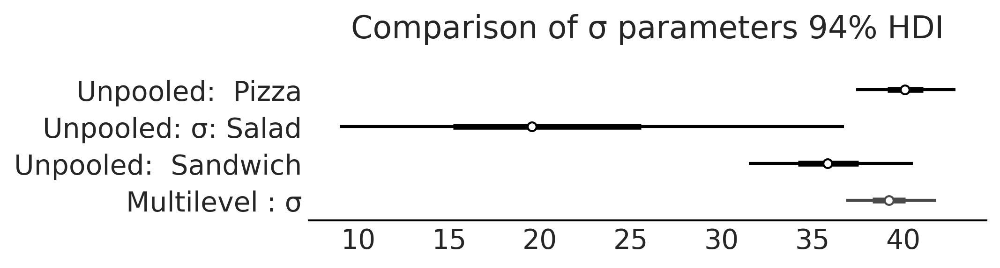

In [50]:
axes = az.plot_forest([inf_data_sales_unpooled,
                       inf_data_pooled_sigma_sales
                      ],
                      model_names = ["Unpooled",
                                     "Multilevel "
                                    ],
                      var_names=["σ"], combined=True, figsize=(7, 1.8));
axes[0].set_title("Comparison of σ parameters 94% HDI")

plt.savefig("img/chp04/salad_sales_forestplot_sigma_unpooled_multilevel_comparison.png")

Text(0.5, 1.0, 'Comparison of β parameters 94% HDI')

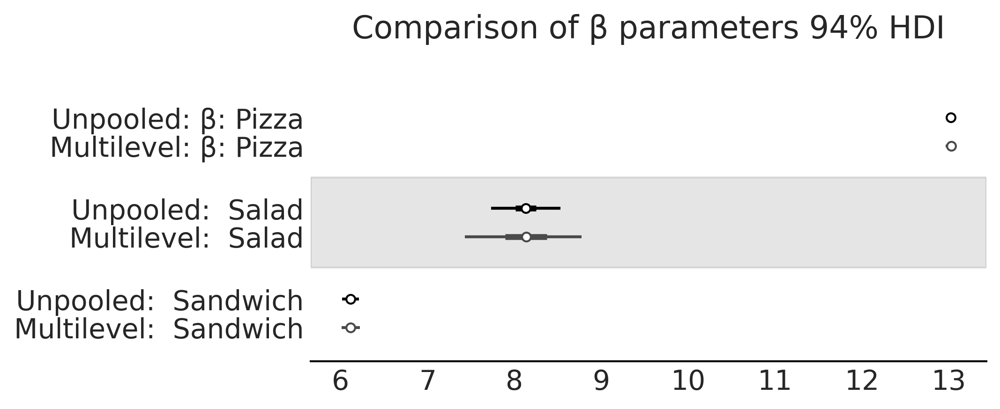

In [51]:
axes = az.plot_forest([inf_data_sales_unpooled,
                       inf_data_pooled_sigma_sales
                      ],
                      model_names = ["Unpooled",
                                     "Multilevel"
                                    ],
                      var_names=["β"], combined=True, figsize=(7, 2.8));
axes[0].set_title("Comparison of β parameters 94% HDI")

In [52]:
inf_posterior_salads = inf_data_pooled_sigma_sales.posterior.sel(β_dim_0="Salad", μ_dim_0=slice(465, 467))

### Hierarchical

### Code 4.12

In [53]:
with pm.Model() as model_hierarchical_sales:
    σ_hyperprior = pm.HalfNormal("σ_hyperprior", 20)
    σ = pm.HalfNormal("σ", σ_hyperprior, shape=3)
    
    β = pm.Normal("β", mu=10, sigma=20, shape=3)
    μ = pm.Deterministic("μ", β[food_category.codes] * customers)
    
    sales = pm.Normal("sales", mu=μ, sigma=σ[food_category.codes],
                      observed=sales_observed)
    
    trace_hierarchical_sales = pm.sample(target_accept=.9)
    
    inf_data_hierarchical_sales = az.from_pymc3(
        trace=trace_hierarchical_sales, 
        coords={"β_dim_0":food_category.categories,
                "σ_dim_0":food_category.categories})

/tmp/ipykernel_19/4230799567.py:11: FutureWarning: In v4.0, pm.sample will return an `arviz.InferenceData` object instead of a `MultiTrace` by default. You can pass return_inferencedata=True or return_inferencedata=False to be safe and silence this warning.
  trace_hierarchical_sales = pm.sample(target_accept=.9)
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [β, σ, σ_hyperprior]


Sampling 4 chains for 1_000 tune and 1_000 draw iterations (4_000 + 4_000 draws total) took 3 seconds.
There was 1 divergence after tuning. Increase `target_accept` or reparameterize.
There was 1 divergence after tuning. Increase `target_accept` or reparameterize.
There were 2 divergences after tuning. Increase `target_accept` or reparameterize.


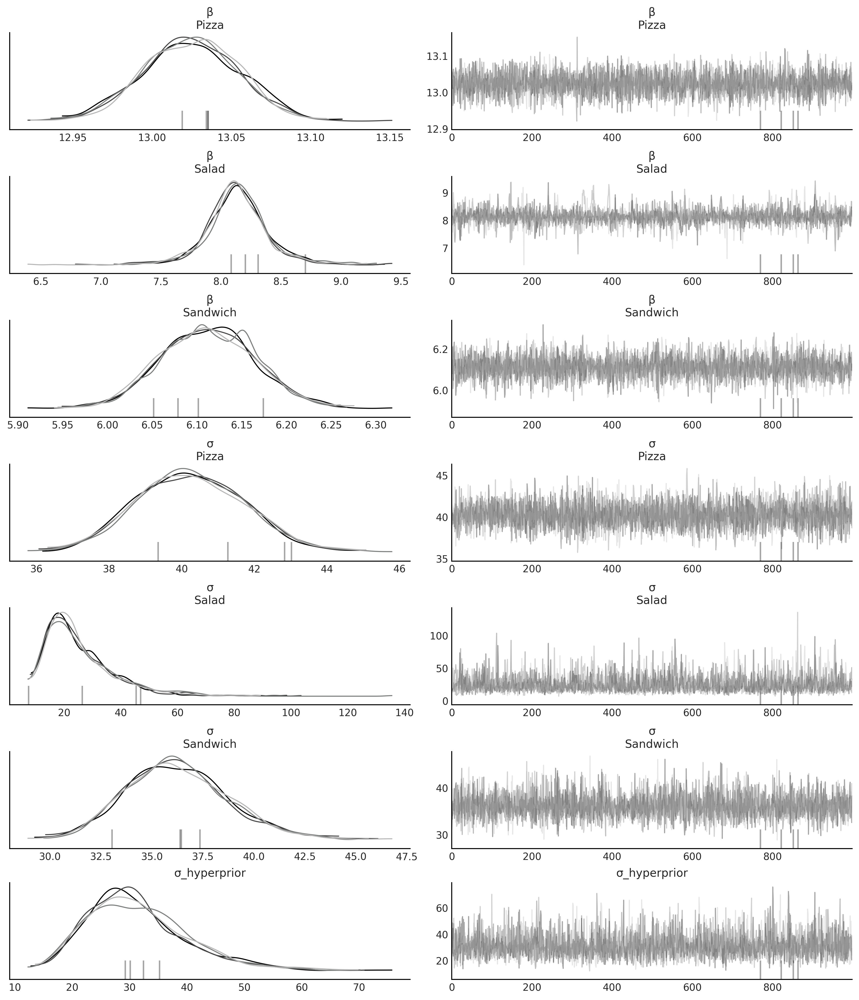

In [54]:
az.plot_trace(inf_data_hierarchical_sales, compact=False, var_names=["β", "σ", "σ_hyperprior"]);

<AxesSubplot:>

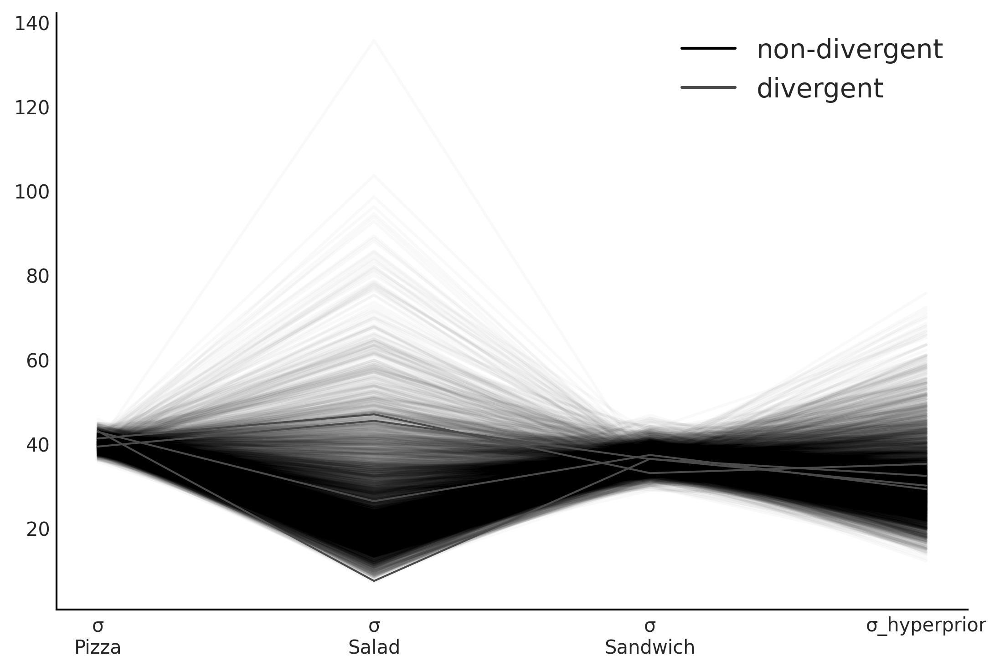

In [55]:
az.plot_parallel(inf_data_hierarchical_sales, var_names=["σ", "σ_hyperprior"])

### Figure 4.23

In [56]:
az.summary(inf_data_hierarchical_sales, var_names=["β", "σ"])

,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_bulk,ess_tail,r_hat
β[0],13.024,0.030,12.970,13.081,0.000,0.000,6105.0,3028.0,1.0
β[1],8.137,0.265,7.625,8.656,0.005,0.004,2978.0,1748.0,1.0
β[2],6.113,0.053,6.016,6.211,0.001,0.001,5455.0,2702.0,1.0
σ[0],40.250,1.486,37.544,43.030,0.021,0.015,5182.0,2706.0,1.0
σ[1],25.635,12.759,8.339,47.768,0.261,0.186,2809.0,2383.0,1.0
σ[2],36.241,2.544,31.805,41.238,0.033,0.024,6008.0,2938.0,1.0


Text(0.5, 1.0, 'Hierarchical β estimates 94% HDI')

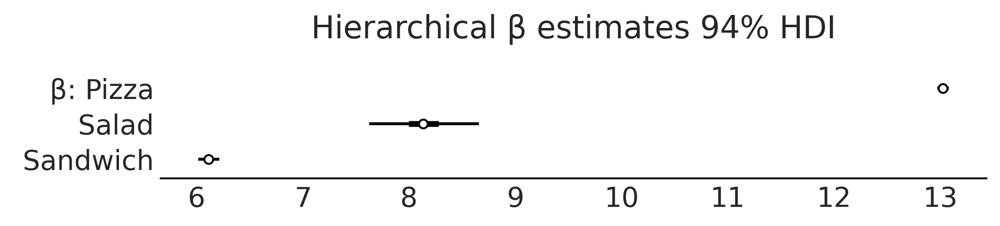

In [57]:
axes = az.plot_forest(inf_data_hierarchical_sales, var_names=["β"], combined=True,  figsize=(7, 1.5))
axes[0].set_title("Hierarchical β estimates 94% HDI")

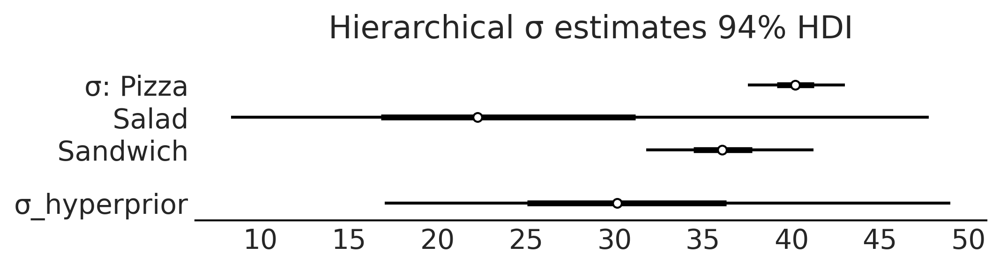

In [58]:
axes = az.plot_forest(inf_data_hierarchical_sales, var_names=["σ", "σ_hyperprior"], combined=True,  figsize=(7, 1.8))
axes[0].set_title("Hierarchical σ estimates 94% HDI")
plt.savefig("img/chp04/salad_sales_forestplot_sigma_hierarchical.png")


In [59]:
print(food_category.categories)

Index(['Pizza', 'Salad', 'Sandwich'], dtype='object')


### Table 4.3

In [60]:
az.summary(inf_data_sales_unpooled.posterior["σ"], kind="stats").round(1)

,mean,sd,hdi_3%,hdi_97%
σ[0],40.1,1.5,37.4,42.9
σ[1],21.2,8.3,9.0,36.7
σ[2],35.9,2.5,31.5,40.5


### Table 4.4

In [61]:
az.summary(inf_data_hierarchical_sales, var_names=["σ", "σ_hyperprior"], kind="stats").round(1)

,mean,sd,hdi_3%,hdi_97%
σ[0],40.2,1.5,37.5,43.0
σ[1],25.6,12.8,8.3,47.8
σ[2],36.2,2.5,31.8,41.2
σ_hyperprior,31.5,9.0,17.0,49.0


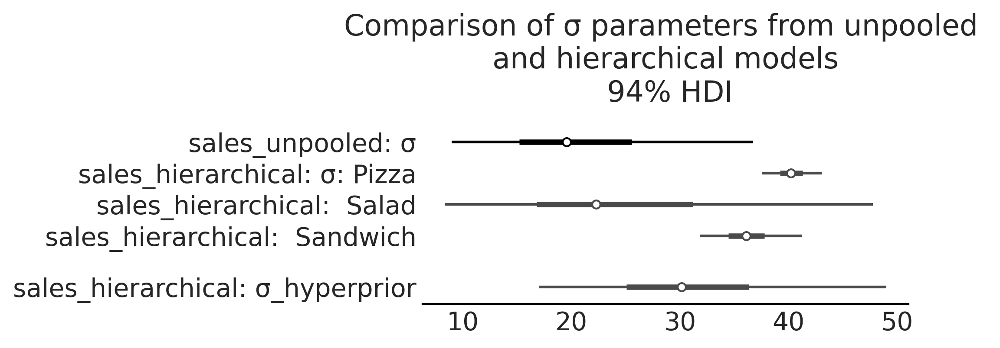

In [62]:
axes = az.plot_forest([inf_data_sales_unpooled.posterior["σ"].isel(σ_dim_0=1),
                       inf_data_hierarchical_sales
                      ],
                      model_names = ["sales_unpooled",
                                     "sales_hierarchical"
                                    ], combined=True, figsize=(7, 2.6),
                     var_names=["σ", "σ_hyperprior"]
                     );
axes[0].set_title("Comparison of σ parameters from unpooled \n and hierarchical models \n 94% HDI")

plt.savefig("img/chp04/salad_sales_forestolot_sigma_unpooled_multilevel_comparison.png")

Text(0.5, 1.0, 'Comparison of Hierarchical versus Unpooled Variance')

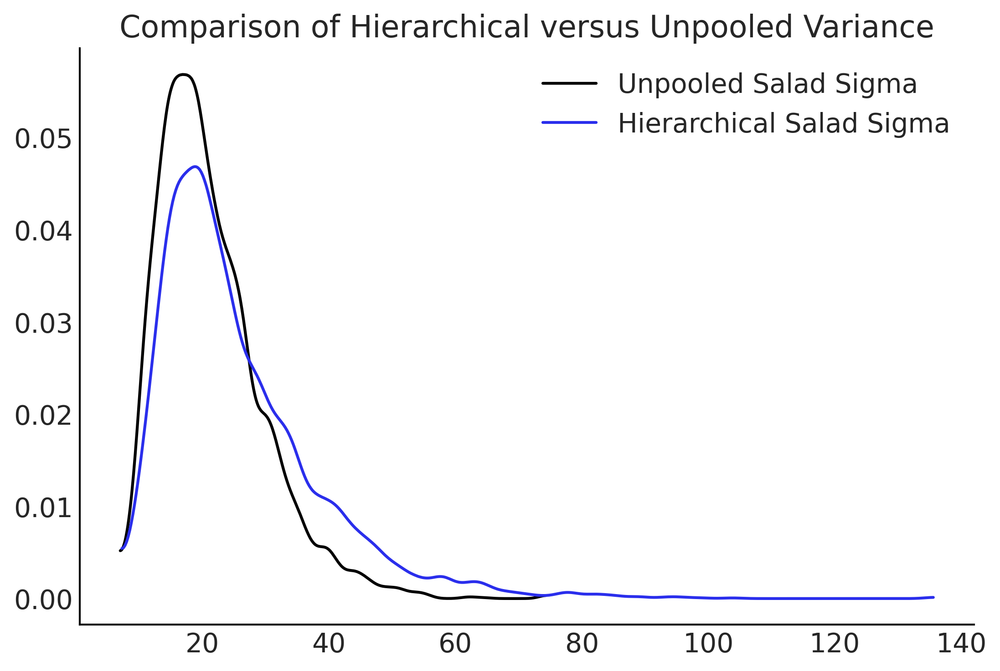

In [63]:
fig, ax = plt.subplots()
az.plot_kde(inf_data_sales_unpooled.posterior['σ'].isel(σ_dim_0=1), label="Unpooled Salad Sigma", ax=ax)
az.plot_kde(inf_data_hierarchical_sales.posterior["σ"].isel(σ_dim_0=1), label="Hierarchical Salad Sigma", plot_kwargs={"color":"C4"}, ax=ax);

ax.set_title("Comparison of Hierarchical versus Unpooled Variance")

### Figure 4.25

Text(0, 0.5, 'y')

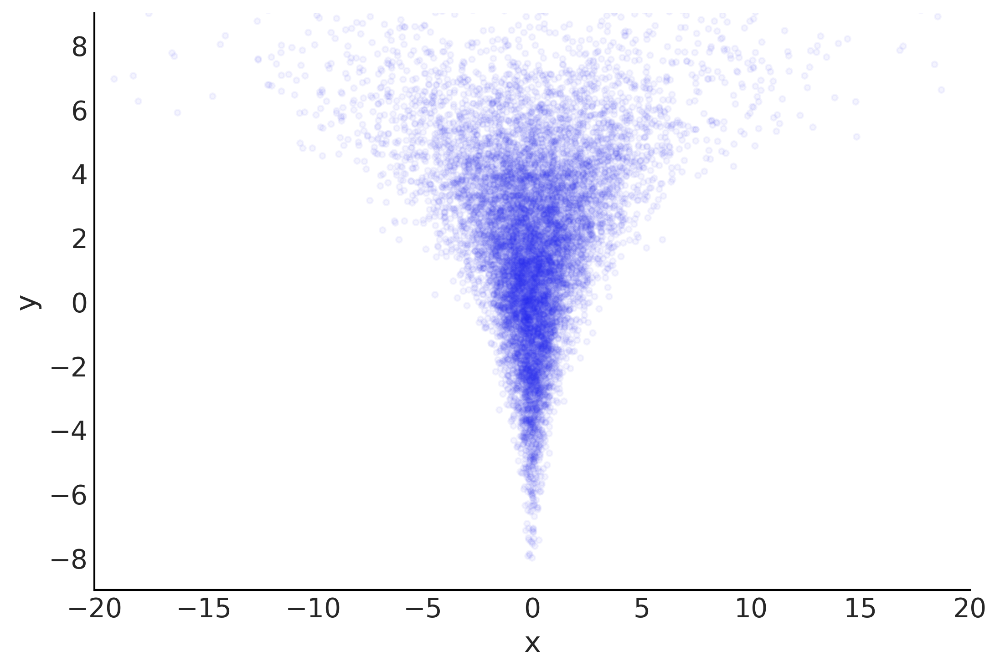

In [64]:
nsample = 10000
nd=1
yr = stats.norm.rvs(loc=2., scale=3., size=nsample)
xnr = stats.norm.rvs(loc=0., scale=np.exp(yr/4), size=(nd, nsample))

fig, ax = plt.subplots()
ax.scatter(xnr[0], yr, marker='.', alpha=.05, color="C4")
ax.set_xlim(-20, 20)
ax.set_ylim(-9, 9)
ax.set_xlabel('x')
ax.set_ylabel('y')

In [65]:
def salad_generator(hyperprior_beta_mean=5, hyperprior_beta_sigma=.2, sigma=50, days_per_location=[6, 4, 15, 10, 3, 5], sigma_per_location=[50,10,20,80,30,20]):
    """Generate noisy salad data"""
    beta_hyperprior = stats.norm(hyperprior_beta_mean, hyperprior_beta_sigma)
    
    # Generate demands days per restaurant
    df = pd.DataFrame()
    for i, days in enumerate(days_per_location):
        np.random.seed(0)

        num_customers = stats.randint(30, 100).rvs(days)
        sales_location = beta_hyperprior.rvs()*num_customers + stats.norm(0, sigma_per_location[i]).rvs(num_customers.shape)

        location_df = pd.DataFrame({"customers":num_customers, "sales":sales_location})
        location_df["location"] = i
        location_df.sort_values(by="customers", ascending=True)
        df = pd.concat([df, location_df])
        
    df.reset_index(inplace=True, drop=True)
    return df
hierarchical_salad_df = salad_generator()

### Figure 4.26

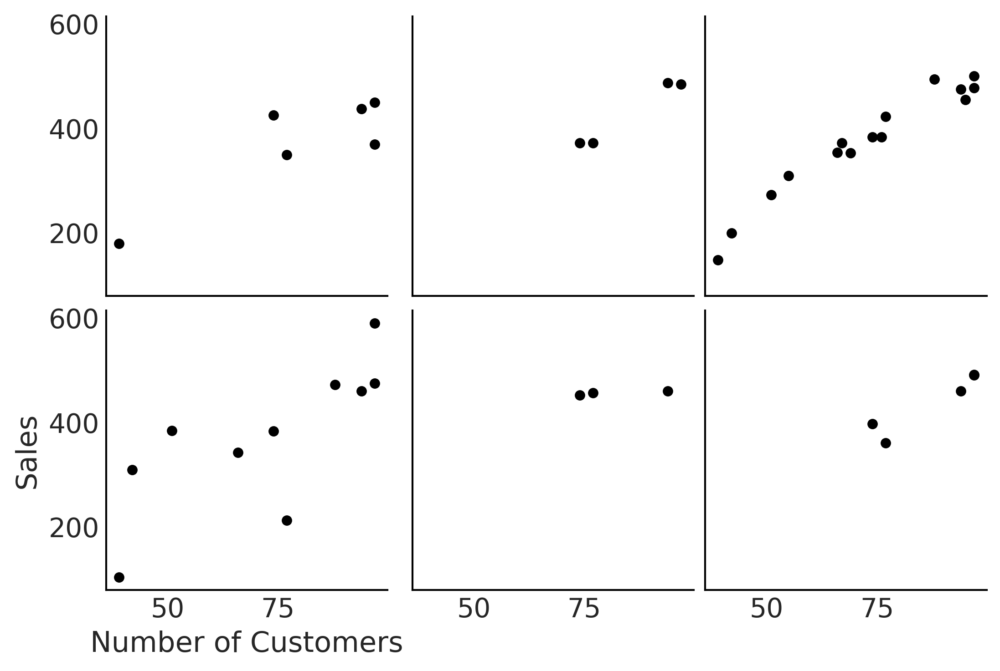

In [66]:
fig, axes, = plt.subplots(2,3, sharex=True, sharey=True)

for i, ax in enumerate(axes.ravel()):
    location_filter = (hierarchical_salad_df["location"] == i)
    hierarchical_salad_df[location_filter].plot(kind="scatter", x="customers", y="sales", ax=ax)
    ax.set_xlabel("")
    ax.set_ylabel("")

    
axes[1,0].set_xlabel("Number of Customers")
axes[1,0].set_ylabel("Sales");
plt.savefig("img/chp04/multiple_salad_sales_scatter.png")

### Code 4.13

In [67]:
import tensorflow as tf
import tensorflow_probability as tfp

tfd = tfp.distributions
root = tfd.JointDistributionCoroutine.Root

In [68]:
run_mcmc = tf.function(
    tfp.experimental.mcmc.windowed_adaptive_nuts,
    autograph=False, jit_compile=True)

In [69]:
def gen_hierarchical_salad_sales(input_df, beta_prior_fn, dtype=tf.float32):
    customers = tf.constant(
        hierarchical_salad_df["customers"].values, dtype=dtype)
    location_category = hierarchical_salad_df["location"].values
    sales = tf.constant(hierarchical_salad_df["sales"].values, dtype=dtype)

    @tfd.JointDistributionCoroutine
    def model_hierarchical_salad_sales():
        β_μ_hyperprior = yield root(tfd.Normal(0, 10, name="beta_mu"))
        β_σ_hyperprior = yield root(tfd.HalfNormal(.1, name="beta_sigma"))
        β = yield from beta_prior_fn(β_μ_hyperprior, β_σ_hyperprior)

        σ_hyperprior = yield root(tfd.HalfNormal(30, name="sigma_prior"))
        σ = yield tfd.Sample(tfd.HalfNormal(σ_hyperprior), 6, name="sigma")

        loc = tf.gather(β, location_category, axis=-1) * customers
        scale = tf.gather(σ, location_category, axis=-1)
        sales = yield tfd.Independent(tfd.Normal(loc, scale),
                                      reinterpreted_batch_ndims=1,
                                      name="sales")

    return model_hierarchical_salad_sales, sales

### Code 4.14 and 4.15

In [70]:
def centered_beta_prior_fn(hyper_mu, hyper_sigma):
    β = yield tfd.Sample(tfd.Normal(hyper_mu, hyper_sigma), 6, name="beta")
    return β

# hierarchical_salad_df is the generated dataset as pandas.DataFrame
centered_model, observed = gen_hierarchical_salad_sales(
    hierarchical_salad_df, centered_beta_prior_fn)

mcmc_samples_centered, sampler_stats_centered = run_mcmc(
    1000, centered_model, n_chains=4, num_adaptation_steps=1000,
    sales=observed)

divergent_per_chain = np.sum(sampler_stats_centered['diverging'], axis=0)
print(f"""There were {divergent_per_chain} divergences after tuning per chain.""")

Instructions for updating:
`scale_identity_multiplier` is deprecated; please combine it into `scale_diag` directly instead.


Instructions for updating:
`scale_identity_multiplier` is deprecated; please combine it into `scale_diag` directly instead.
2022-09-18 20:07:58.231676: W tensorflow/compiler/tf2xla/kernels/random_ops.cc:102] Warning: Using tf.random.uniform with XLA compilation will ignore seeds; consider using tf.random.stateless_uniform instead if reproducible behavior is desired. sanitize_seed/seed
2022-09-18 20:07:58.325981: W tensorflow/compiler/tf2xla/kernels/assert_op.cc:38] Ignoring Assert operator mcmc_retry_init/assert_equal_1/Assert/AssertGuard/Assert


There were [28 49 83 44] divergences after tuning per chain.


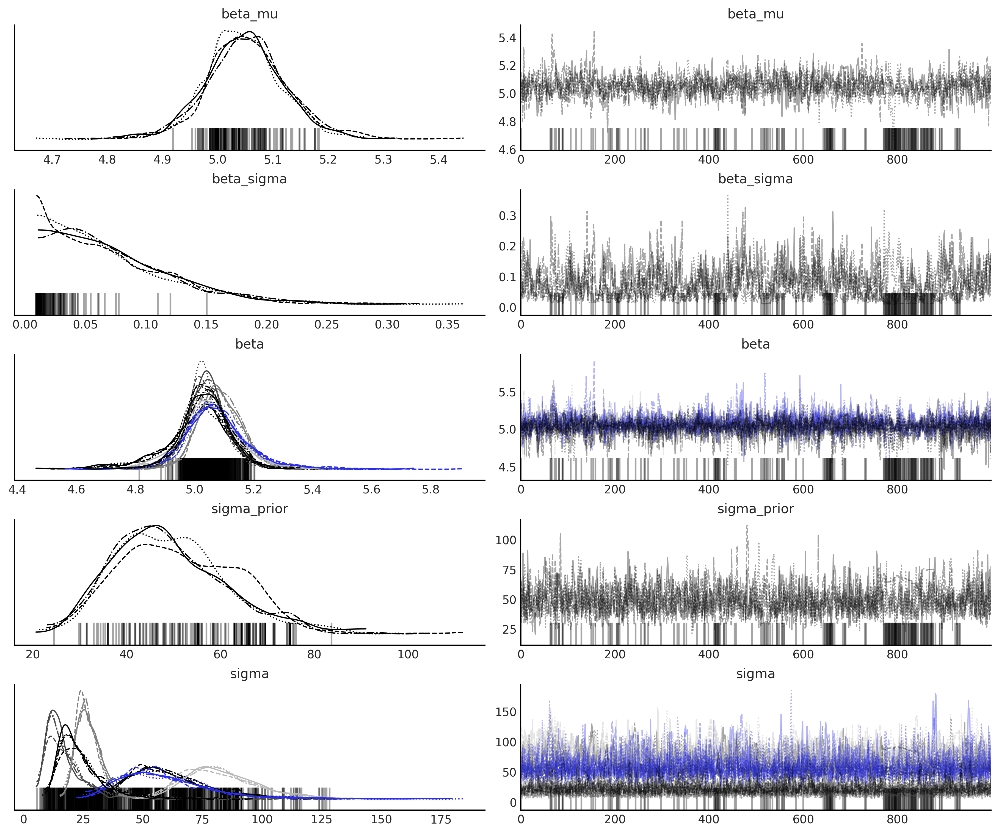

In [71]:
idata_centered_model = az.from_dict(
    posterior={
        k:np.swapaxes(v, 1, 0)
        for k, v in mcmc_samples_centered._asdict().items()},
    sample_stats={
        k:np.swapaxes(sampler_stats_centered[k], 1, 0)
        for k in ["target_log_prob", "diverging", "accept_ratio", "n_steps"]}
)

az.plot_trace(idata_centered_model, compact=True);

In [72]:
az.summary(idata_centered_model)

,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_bulk,ess_tail,r_hat
beta_mu,5.050,0.073,4.909,5.182,0.003,0.002,851.0,1095.0,1.01
beta_sigma,0.074,0.051,0.010,0.167,0.003,0.002,273.0,124.0,1.01
beta[0],5.011,0.115,4.777,5.218,0.003,0.002,1340.0,1574.0,1.00
beta[1],5.040,0.073,4.908,5.172,0.002,0.002,1268.0,1172.0,1.01
beta[2],5.083,0.075,4.950,5.229,0.002,0.002,852.0,2027.0,1.00
beta[3],5.054,0.103,4.858,5.269,0.003,0.002,1463.0,1983.0,1.00
beta[4],5.076,0.112,4.869,5.294,0.003,0.002,1181.0,1530.0,1.00
beta[5],5.038,0.079,4.891,5.187,0.002,0.002,1189.0,1473.0,1.00
sigma_prior,49.684,12.310,28.593,72.436,0.437,0.309,850.0,862.0,1.00
sigma[0],60.808,16.530,34.059,94.105,0.540,0.408,1154.0,856.0,1.01


### Figure 4.27

/usr/local/lib/python3.8/dist-packages/arviz/plots/jointplot.py:144: UserWarning: plot_joint will be deprecated. Please use plot_pair instead.
  warnings.warn("plot_joint will be deprecated. Please use plot_pair instead.")


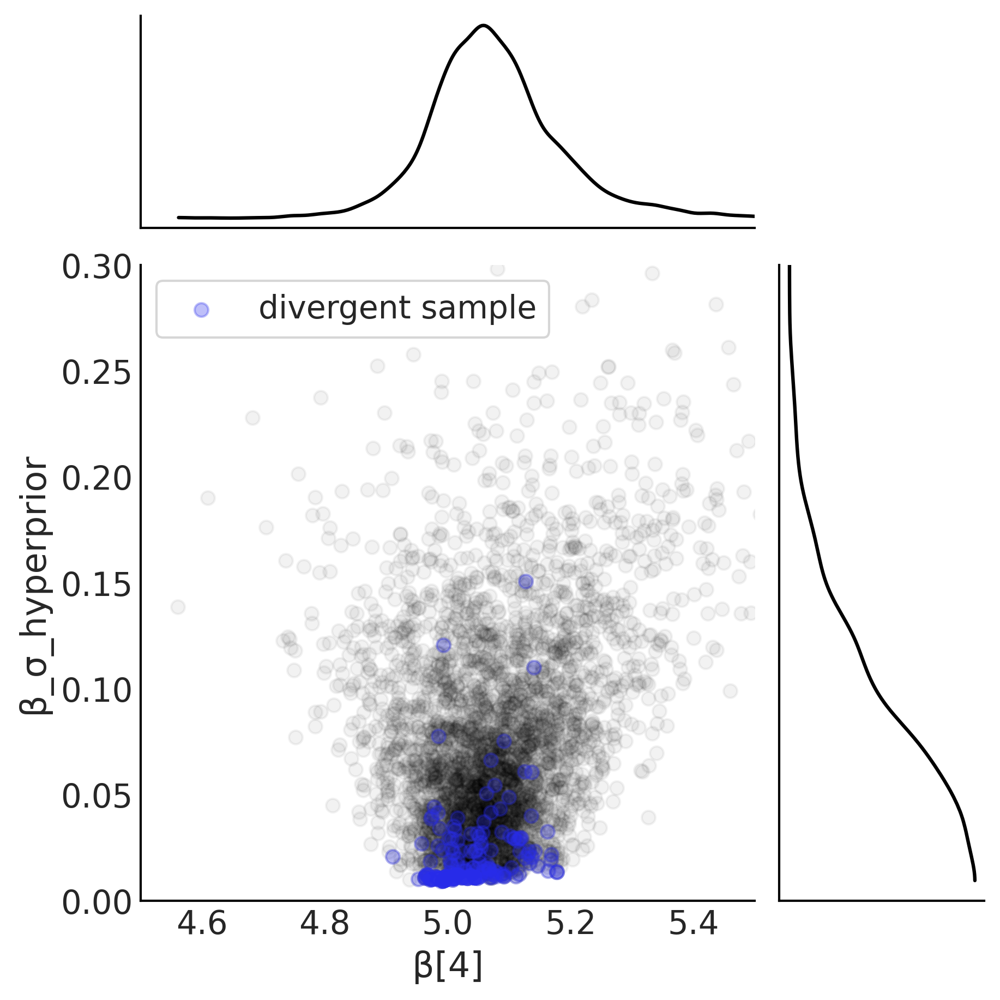

In [73]:
slope = mcmc_samples_centered.beta[..., 4].numpy().flatten()
sigma = mcmc_samples_centered.beta_sigma.numpy().flatten()
divergences = sampler_stats_centered['diverging'].numpy().flatten()

axes = az.plot_joint({"β[4]": slope, "β_σ_hyperprior": sigma},
                     joint_kwargs={"alpha": .05}, figsize=(6, 6))
axes[0].scatter(slope[divergences], sigma[divergences], c="C4", alpha=.3, label='divergent sample')
axes[0].legend(frameon=True)
axes[0].set_ylim(0, .3)
axes[0].set_xlim(4.5, 5.5)

plt.savefig("img/chp04/Neals_Funnel_Salad_Centered.png")

### Code 4.16

In [74]:
def non_centered_beta_prior_fn(hyper_mu, hyper_sigma):
    β_offset = yield root(tfd.Sample(tfd.Normal(0, 1), 6, name="beta_offset"))
    return β_offset * hyper_sigma[..., None] + hyper_mu[..., None]

# hierarchical_salad_df is the generated dataset as pandas.DataFrame
non_centered_model, observed = gen_hierarchical_salad_sales(
    hierarchical_salad_df, non_centered_beta_prior_fn)

mcmc_samples_noncentered, sampler_stats_noncentered = run_mcmc(
    1000, non_centered_model, n_chains=4, num_adaptation_steps=1000,
    sales=observed)

divergent_per_chain = np.sum(sampler_stats_noncentered['diverging'], axis=0)
print(f"""There were {divergent_per_chain} divergences after tuning per chain.""")

2022-09-18 20:09:20.345590: W tensorflow/compiler/tf2xla/kernels/assert_op.cc:38] Ignoring Assert operator mcmc_retry_init/assert_equal_1/Assert/AssertGuard/Assert


There were [1 1 1 0] divergences after tuning per chain.


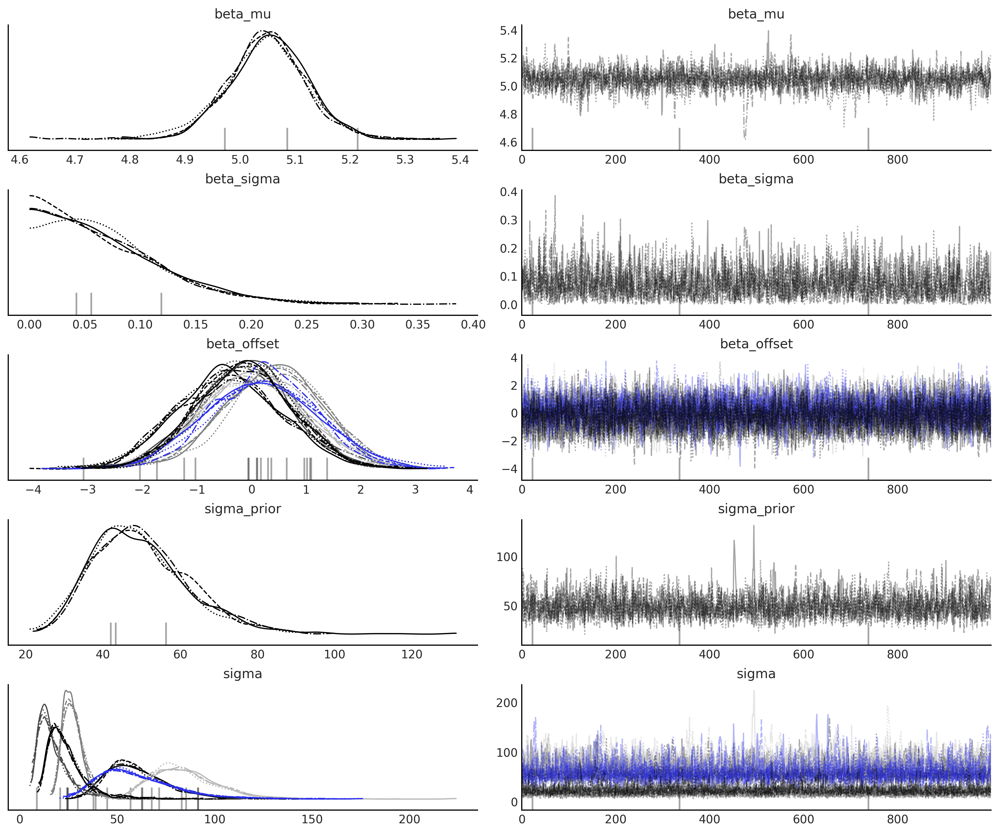

In [75]:
idata_non_centered_model = az.from_dict(
    posterior={
        k:np.swapaxes(v, 1, 0)
        for k, v in mcmc_samples_noncentered._asdict().items()},
    sample_stats={
        k:np.swapaxes(sampler_stats_noncentered[k], 1, 0)
        for k in ["target_log_prob", "diverging", "accept_ratio", "n_steps"]}
)

az.plot_trace(idata_non_centered_model, compact=True);

In [76]:
az.summary(idata_non_centered_model)

,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_bulk,ess_tail,r_hat
beta_mu,5.048,0.073,4.913,5.182,0.002,0.001,1776.0,1704.0,1.0
beta_sigma,0.070,0.054,0.000,0.168,0.001,0.001,1317.0,997.0,1.0
beta_offset[0],-0.387,0.995,-2.177,1.452,0.016,0.015,3888.0,2576.0,1.0
beta_offset[1],-0.091,0.882,-1.813,1.489,0.016,0.014,2961.0,2449.0,1.0
beta_offset[2],0.399,0.913,-1.324,2.080,0.017,0.014,2796.0,2781.0,1.0
beta_offset[3],0.045,0.978,-1.887,1.834,0.014,0.017,4758.0,2613.0,1.0
beta_offset[4],0.219,1.015,-1.733,2.046,0.017,0.017,3416.0,2423.0,1.0
beta_offset[5],-0.134,0.867,-1.710,1.517,0.015,0.013,3314.0,2692.0,1.0
sigma_prior,49.715,12.373,28.132,72.924,0.265,0.199,2558.0,1993.0,1.0
sigma[0],60.433,16.324,34.296,91.887,0.344,0.266,2898.0,1809.0,1.0


### Figure  4.28

/usr/local/lib/python3.8/dist-packages/arviz/plots/jointplot.py:144: UserWarning: plot_joint will be deprecated. Please use plot_pair instead.
  warnings.warn("plot_joint will be deprecated. Please use plot_pair instead.")


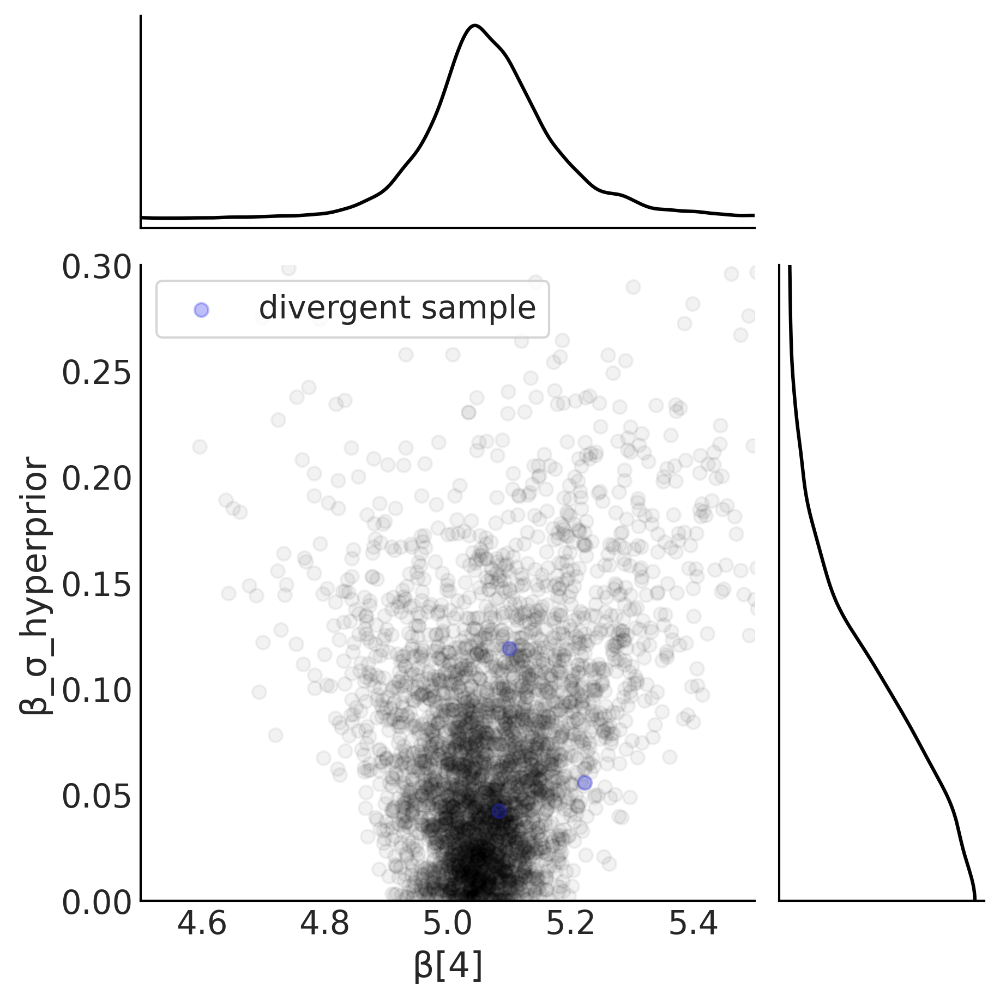

In [77]:
noncentered_beta = (mcmc_samples_noncentered.beta_mu[..., None]
        + mcmc_samples_noncentered.beta_offset * mcmc_samples_noncentered.beta_sigma[..., None])
slope = noncentered_beta[..., 4].numpy().flatten()
sigma = mcmc_samples_noncentered.beta_sigma.numpy().flatten()
divergences = sampler_stats_noncentered['diverging'].numpy().flatten()

axes = az.plot_joint({"β[4]": slope, "β_σ_hyperprior": sigma},
                     joint_kwargs={"alpha": .05}, figsize=(6, 6))
axes[0].scatter(slope[divergences], sigma[divergences], c="C4", alpha=.3, label='divergent sample')
axes[0].legend(frameon=True)
axes[0].set_ylim(0, .3)
axes[0].set_xlim(4.5, 5.5)

plt.savefig("img/chp04/Neals_Funnel_Salad_NonCentered.png")

### Figure 4.29

In [78]:
centered_β_sigma = mcmc_samples_centered.beta_sigma.numpy()
noncentered_β_sigma = mcmc_samples_noncentered.beta_sigma.numpy()

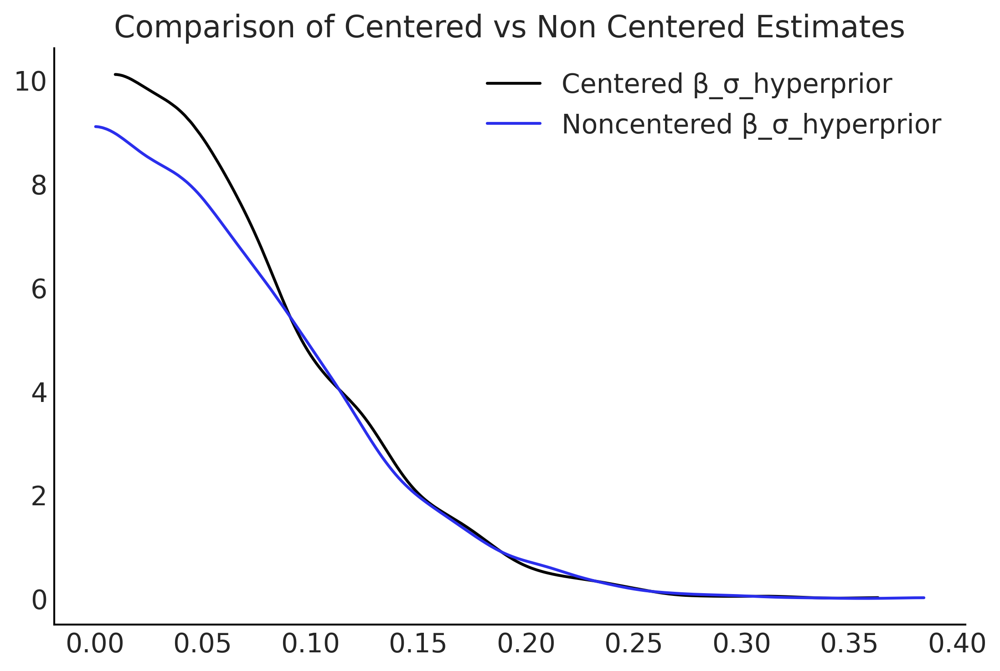

In [79]:
fig, ax = plt.subplots()
az.plot_kde(centered_β_sigma, label="Centered β_σ_hyperprior", ax=ax)
az.plot_kde(noncentered_β_sigma, label="Noncentered β_σ_hyperprior", plot_kwargs={"color":"C4"}, ax=ax);

ax.set_title("Comparison of Centered vs Non Centered Estimates");
plt.savefig("img/chp04/Salad_Sales_Hierarchical_Comparison.png")

### Code 4.17

In [80]:
out_of_sample_customers = 50.

@tfd.JointDistributionCoroutine
def out_of_sample_prediction_model():
    model = yield root(non_centered_model)
    β = model.beta_offset * model.beta_sigma[..., None] + model.beta_mu[..., None]
    
    β_group = yield tfd.Normal(
        model.beta_mu, model.beta_sigma, name="group_beta_prediction")
    group_level_prediction = yield tfd.Normal(
        β_group * out_of_sample_customers,
        model.sigma_prior,
        name="group_level_prediction")
    for l in [2, 4]:
        yield tfd.Normal(
            tf.gather(β, l, axis=-1) * out_of_sample_customers,
            tf.gather(model.sigma, l, axis=-1),
            name=f"location_{l}_prediction")

amended_posterior = tf.nest.pack_sequence_as(
    non_centered_model.sample(),
    list(mcmc_samples_noncentered) + [observed],
)
ppc = out_of_sample_prediction_model.sample(var0=amended_posterior)

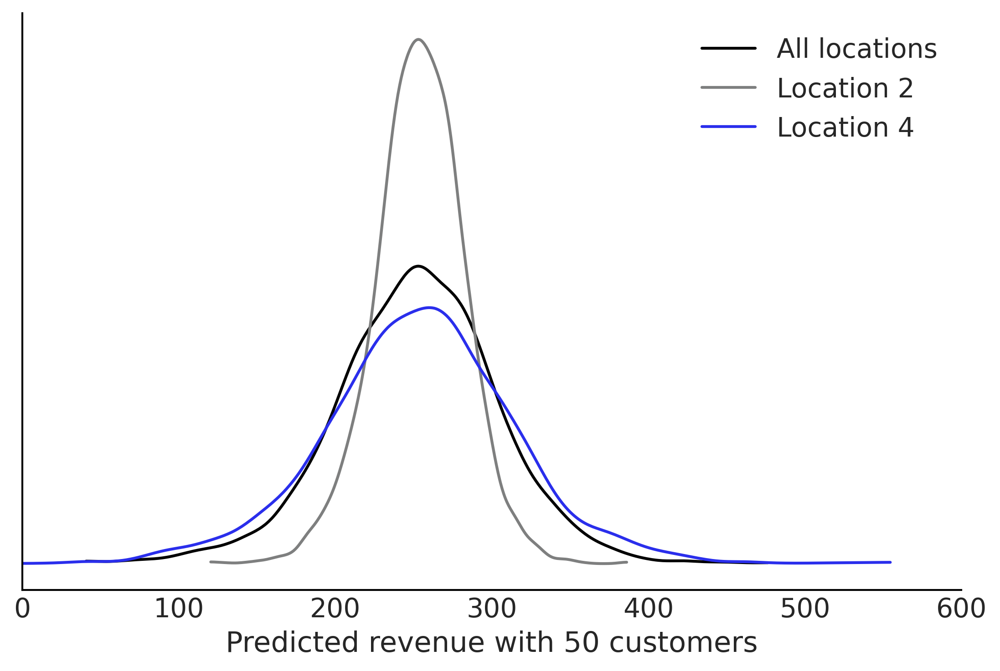

In [81]:
fig, ax = plt.subplots()

az.plot_kde(ppc.group_level_prediction, plot_kwargs={"color":"C0"}, ax=ax, label="All locations")
az.plot_kde(ppc.location_2_prediction, plot_kwargs={"color":"C2"}, ax=ax, label="Location 2")
az.plot_kde(ppc.location_4_prediction, plot_kwargs={"color":"C4"}, ax=ax, label="Location 4")

ax.set_xlabel("Predicted revenue with 50 customers")
ax.set_xlim([0,600])

ax.set_yticks([])

plt.savefig("img/chp04/Salad_Sales_Hierarchical_Predictions.png")

### Code 4.18

In [82]:
out_of_sample_customers2 = np.arange(50, 90)

@tfd.JointDistributionCoroutine
def out_of_sample_prediction_model2():
    model = yield root(non_centered_model)
    
    β_new_loc = yield tfd.Normal(
        model.beta_mu, model.beta_sigma, name="beta_new_loc")
    σ_new_loc = yield tfd.HalfNormal(model.sigma_prior, name="sigma_new_loc")
    group_level_prediction = yield tfd.Normal(
        β_new_loc[..., None] * out_of_sample_customers2,
        σ_new_loc[..., None],
        name="new_location_prediction")

ppc = out_of_sample_prediction_model2.sample(var0=amended_posterior)

/usr/local/lib/python3.8/dist-packages/arviz/data/base.py:169: UserWarning: More chains (1000) than draws (4). Passed array should have shape (chains, draws, *shape)
  warnings.warn(


<AxesSubplot:>

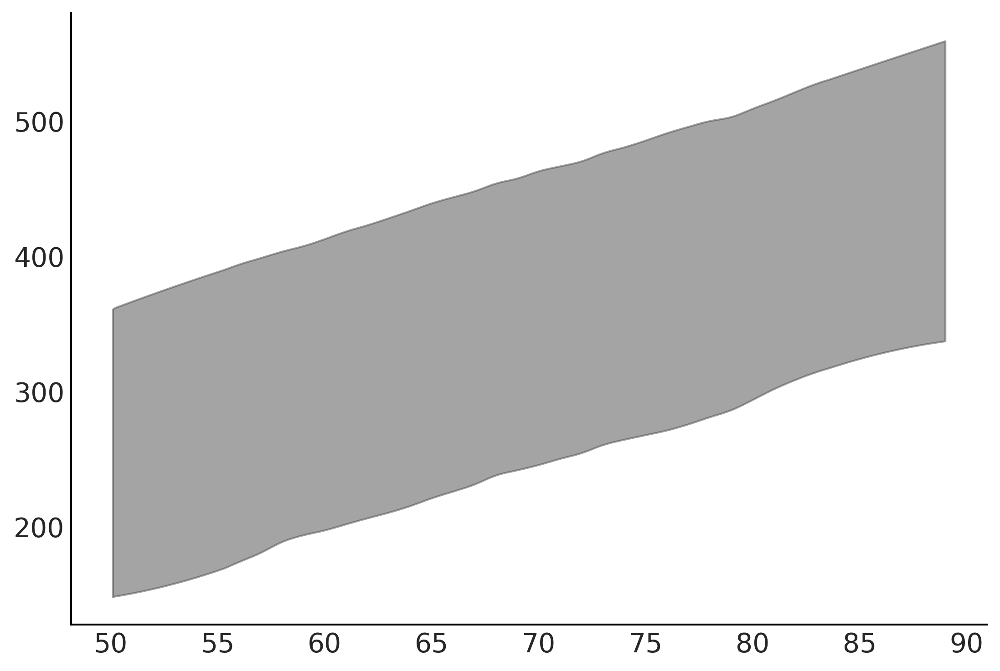

In [83]:
az.plot_hdi(out_of_sample_customers2, ppc.new_location_prediction, hdi_prob=.95)

# 4.7 Exercises

## Problem 4E7

In [84]:
models={"baby_model_linear": inf_data_linear,"baby_model_sqrt": inf_data_sqrt }
az.compare(models).round(1)

/usr/local/lib/python3.8/dist-packages/arviz/stats/stats.py:145: UserWarning: The default method used to estimate the weights for each model,has changed from BB-pseudo-BMA to stacking
  warnings.warn(


,rank,loo,p_loo,d_loo,weight,se,dse,warning,loo_scale
baby_model_sqrt,0,-1968.2,3.1,0.0,0.9,19.0,0.0,False,log
baby_model_linear,1,-2133.3,3.2,165.1,0.1,18.6,20.1,False,log


# Problem 4E8

Auto-assigning NUTS sampler...
INFO:pymc3:Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
INFO:pymc3:Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (4 chains in 4 jobs)
INFO:pymc3:Multiprocess sampling (4 chains in 4 jobs)
NUTS: [β_1, β_0, σ]
INFO:pymc3:NUTS: [β_1, β_0, σ]


Sampling 4 chains for 1_000 tune and 1_000 draw iterations (4_000 + 4_000 draws total) took 8 seconds.
INFO:pymc3:Sampling 4 chains for 1_000 tune and 1_000 draw iterations (4_000 + 4_000 draws total) took 8 seconds.
Auto-assigning NUTS sampler...
INFO:pymc3:Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
INFO:pymc3:Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (4 chains in 4 jobs)
INFO:pymc3:Multiprocess sampling (4 chains in 4 jobs)
NUTS: [β_3, β_2, β_1, β_0, σ]
INFO:pymc3:NUTS: [β_3, β_2, β_1, β_0, σ]


Sampling 4 chains for 1_000 tune and 1_000 draw iterations (4_000 + 4_000 draws total) took 28 seconds.
INFO:pymc3:Sampling 4 chains for 1_000 tune and 1_000 draw iterations (4_000 + 4_000 draws total) took 28 seconds.
The number of effective samples is smaller than 25% for some parameters.
INFO:pymc3:The number of effective samples is smaller than 25% for some parameters.
/usr/local/lib/python3.8/dist-packages/arviz/stats/stats.py:145: UserWarning: The default method used to estimate the weights for each model,has changed from BB-pseudo-BMA to stacking
  warnings.warn(


        rank     loo  p_loo  d_loo  weight    se  dse  warning loo_scale
model2     0 -2446.4    4.5    0.0     1.0  13.1  0.0    False       log
model1     1 -2464.2    3.0   17.7     0.0  13.0  5.5    False       log


Text(0.5, 1.0, 'σ Comparison 94.0 HDI')

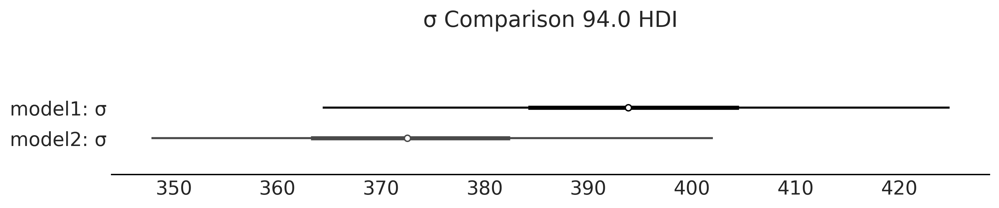

In [85]:
penguins = pd.read_csv("../data/penguins.csv")
missing_data = penguins.isnull()[["bill_length_mm", "flipper_length_mm", "sex", "body_mass_g"]].any(axis=1)
penguins = penguins.loc[~missing_data]
all_species = pd.Categorical(penguins["species"])


with pm.Model() as model1:
    σ = pm.HalfStudentT("σ", 100, 2000)
    β_0 = pm.Normal("β_0", 0, 3000)
    β_1 = pm.Normal("β_1", 0, 3000)
    μ = pm.Deterministic("μ", β_0 + β_1 * penguins["flipper_length_mm"])
    mass = pm.Normal("mass", mu=μ, sigma=σ, observed=penguins["body_mass_g"])
    inf_data1 = pm.sample(target_accept=.9, return_inferencedata=True)

with pm.Model() as model2:
    σ = pm.HalfStudentT("σ", 100, 2000)
    β_0 = pm.Normal("β_0", 0, 3000)
    β_1 = pm.Normal("β_1", 0, 3000)
    β_2 = pm.Normal("β_2", 0, 3000)
    β_3 = pm.Normal("β_3", 0, 3000)
    μ = pm.Deterministic("μ", β_0 + β_1 * penguins["flipper_length_mm"] + β_2 * all_species.codes \
                        + β_3 * all_species.codes * penguins["flipper_length_mm"])
    mass = pm.Normal("mass", mu=μ, sigma=σ, observed=penguins["body_mass_g"])
    inf_data2 = pm.sample(target_accept=.9, return_inferencedata=True)

models={"model1": inf_data1,"model2": inf_data2 }
print(az.compare(models).round(1))
axes = az.plot_forest([inf_data1,inf_data2],model_names=["model1","model2"],var_names=["σ"], combined=True, figsize=(10,2))
axes[0].set_title("σ Comparison 94.0 HDI")


## Problem 4M9

In [86]:
#Uncomment to install seaborn below
#!pip install seaborn
import seaborn as sns
anscombe = sns.load_dataset('anscombe')
data=anscombe[anscombe.dataset=='III'].drop(columns='dataset')

with pm.Model() as model1:
    σ = pm.HalfNormal("σ", 25)
    β = pm.Normal('β', mu=0, sigma=1)
    μ = pm.Deterministic("μ", β * data["x"])
    y1 = pm.Normal("y1", mu=μ, sigma=σ, observed=data["y"])
    trace1 = pm.sample(random_seed=1)
    ppc1 = pm.sample_posterior_predictive(trace1)
    inf_data1 = az.from_pymc3(trace = trace1,posterior_predictive=ppc1)

with pm.Model() as model2:
    σ = pm.HalfNormal("σ", 25)
    β = pm.Normal("β", mu=0, sigma=1)
    ν = pm.HalfNormal("ν", 20)
    μ = pm.Deterministic("μ", β * data["x"])
    y2 = pm.StudentT("y2", mu=μ, sigma=σ, nu=ν,observed=data["y"])
    trace2 = pm.sample(random_seed=1)
    ppc2 = pm.sample_posterior_predictive(trace2)
    inf_data2 = az.from_pymc3(trace = trace2)#,posterior_predictive=ppc2)

az.compare({"Non robust": inf_data1, "Robust":inf_data2})

/tmp/ipykernel_19/317049117.py:12: FutureWarning: In v4.0, pm.sample will return an `arviz.InferenceData` object instead of a `MultiTrace` by default. You can pass return_inferencedata=True or return_inferencedata=False to be safe and silence this warning.
  trace1 = pm.sample(random_seed=1)
Auto-assigning NUTS sampler...
INFO:pymc3:Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
INFO:pymc3:Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (4 chains in 4 jobs)
INFO:pymc3:Multiprocess sampling (4 chains in 4 jobs)
NUTS: [β, σ]
INFO:pymc3:NUTS: [β, σ]


Sampling 4 chains for 1_000 tune and 1_000 draw iterations (4_000 + 4_000 draws total) took 1 seconds.
INFO:pymc3:Sampling 4 chains for 1_000 tune and 1_000 draw iterations (4_000 + 4_000 draws total) took 1 seconds.


/tmp/ipykernel_19/317049117.py:22: FutureWarning: In v4.0, pm.sample will return an `arviz.InferenceData` object instead of a `MultiTrace` by default. You can pass return_inferencedata=True or return_inferencedata=False to be safe and silence this warning.
  trace2 = pm.sample(random_seed=1)
Auto-assigning NUTS sampler...
INFO:pymc3:Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
INFO:pymc3:Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (4 chains in 4 jobs)
INFO:pymc3:Multiprocess sampling (4 chains in 4 jobs)
NUTS: [ν, β, σ]
INFO:pymc3:NUTS: [ν, β, σ]


Sampling 4 chains for 1_000 tune and 1_000 draw iterations (4_000 + 4_000 draws total) took 2 seconds.
INFO:pymc3:Sampling 4 chains for 1_000 tune and 1_000 draw iterations (4_000 + 4_000 draws total) took 2 seconds.
There were 5 divergences after tuning. Increase `target_accept` or reparameterize.
ERROR:pymc3:There were 5 divergences after tuning. Increase `target_accept` or reparameterize.


/usr/local/lib/python3.8/dist-packages/arviz/stats/stats.py:145: UserWarning: The default method used to estimate the weights for each model,has changed from BB-pseudo-BMA to stacking
  warnings.warn(


,rank,loo,p_loo,d_loo,weight,se,dse,warning,loo_scale
Non robust,0,-22.333430,1.639306,0.000000,1.0,1.598141,0.000000,False,log
Robust,1,-22.478667,1.614697,0.145237,0.0,1.589685,0.085346,False,log


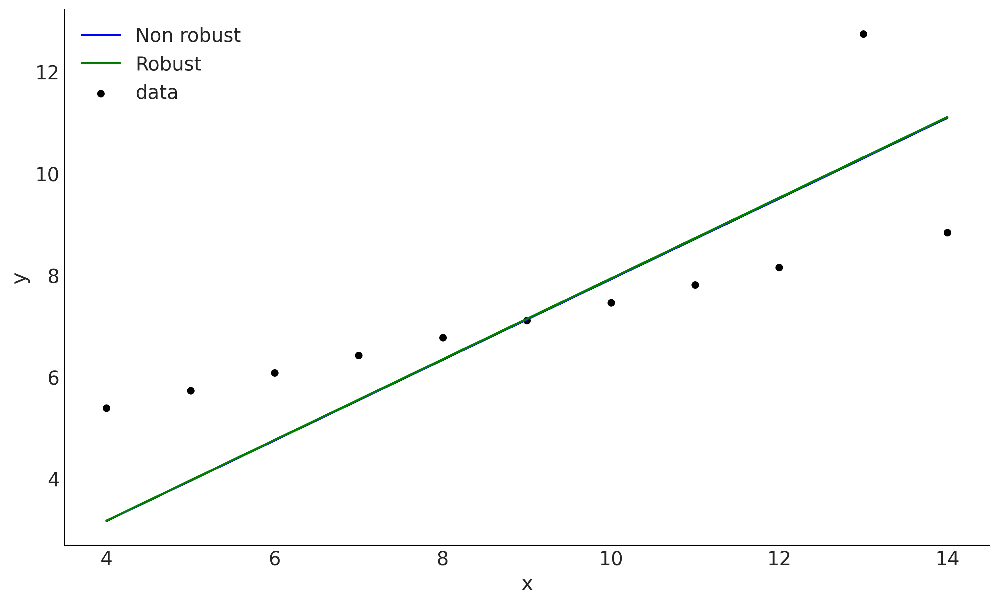

In [87]:
fig, ax = plt.subplots(figsize=(10, 6))
μ_m = inf_data1.posterior["μ"].values.reshape(-1, data.shape[0]).mean(axis=0)
μ_m2= inf_data2.posterior["μ"].values.reshape(-1, data.shape[0]).mean(axis=0)
ax.plot(data.x, μ_m, c='b',label='Non robust')
ax.plot(data.x, μ_m2, c='g',label='Robust')
data.plot(x="x", y="y", kind="scatter", ax=ax,label='data')
ax.legend()

## 4M10

Auto-assigning NUTS sampler...
INFO:pymc3:Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
INFO:pymc3:Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (4 chains in 4 jobs)
INFO:pymc3:Multiprocess sampling (4 chains in 4 jobs)
NUTS: [μ, σ, μ0]
INFO:pymc3:NUTS: [μ, σ, μ0]


Sampling 4 chains for 1_000 tune and 1_000 draw iterations (4_000 + 4_000 draws total) took 2 seconds.
INFO:pymc3:Sampling 4 chains for 1_000 tune and 1_000 draw iterations (4_000 + 4_000 draws total) took 2 seconds.


Text(0.5, 1.0, 'Empirical μ0=4207')

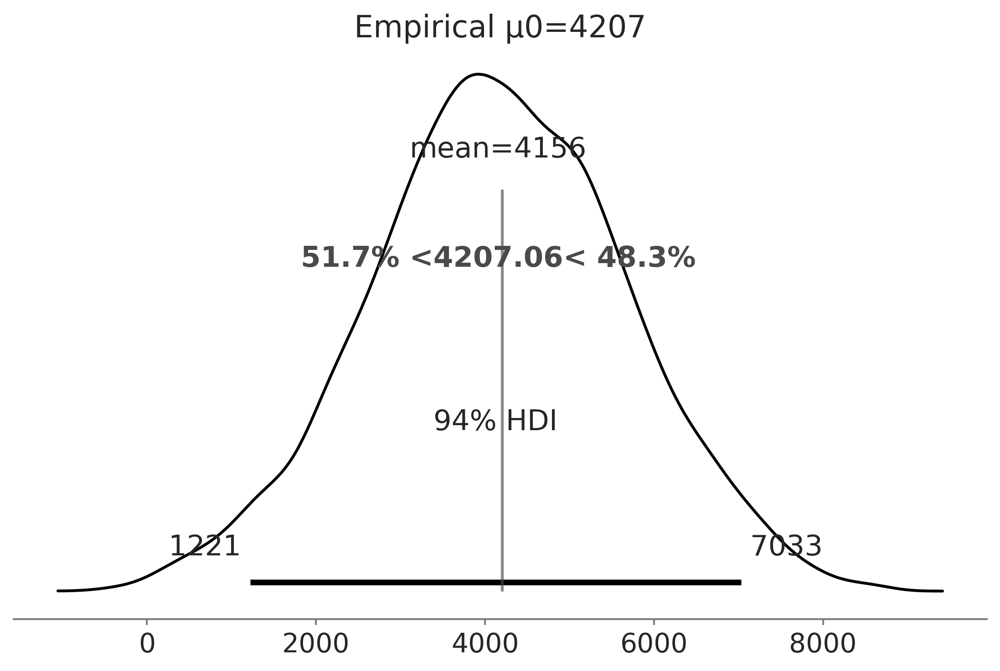

In [88]:

with pm.Model() as hierarchical_model_penguin_mass_all_species:
    # Note the addition of the shape parameter
    μ0= pm.Normal("μ0", 4000, 3000)
    σ = pm.HalfStudentT("σ", 100, 2000, shape=3)
    μ = pm.Normal("μ", μ0, 3000, shape=3)
    mass = pm.Normal("mass",mu=μ[all_species.codes],sigma=σ[all_species.codes],observed=penguins["body_mass_g"])
    trace = pm.sample(return_inferencedata=False)
    idata = az.from_pymc3(trace=trace)
ax=az.plot_posterior(idata, var_names=['μ0'],ref_val=penguins["body_mass_g"].mean())
ax.set_title("Empirical μ0=%3.f"%(penguins["body_mass_g"].mean()))

## 4M11

In [129]:
concrete= pd.read_csv("../exercises/data/concrete.csv")
with pm.Model() as model:
    water=pm.Data("water",concrete['water'].values)
    cement=pm.Data("cement",concrete['cement'].values)
    y_obs=pm.Data("y_obs",concrete['CCS'].values)
    σ = pm.HalfStudentT("σ", 100, 2000)
    β0=pm.Normal("β0", 0, 3000)
    βw=pm.Normal("βw", 0, 3000)
    βc = pm.Normal("βc", 0, 3000)
    βwc = pm.Normal("βwc", 0, 3000)
    mu=β0 + βw*water + βc*cement + βwc*water*cement
    μ = pm.Deterministic("μ",mu)
    y = pm.Normal("y", mu=μ, sigma=σ, observed=y_obs)
    idata= pm.sample(target_accept=.9, return_inferencedata=True,chains=4)

Auto-assigning NUTS sampler...
INFO:pymc3:Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
INFO:pymc3:Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (4 chains in 4 jobs)
INFO:pymc3:Multiprocess sampling (4 chains in 4 jobs)
NUTS: [βwc, βc, βw, β0, σ]
INFO:pymc3:NUTS: [βwc, βc, βw, β0, σ]


Sampling 4 chains for 1_000 tune and 1_000 draw iterations (4_000 + 4_000 draws total) took 27 seconds.
INFO:pymc3:Sampling 4 chains for 1_000 tune and 1_000 draw iterations (4_000 + 4_000 draws total) took 27 seconds.
The number of effective samples is smaller than 25% for some parameters.
INFO:pymc3:The number of effective samples is smaller than 25% for some parameters.


-0.0004234509187000679


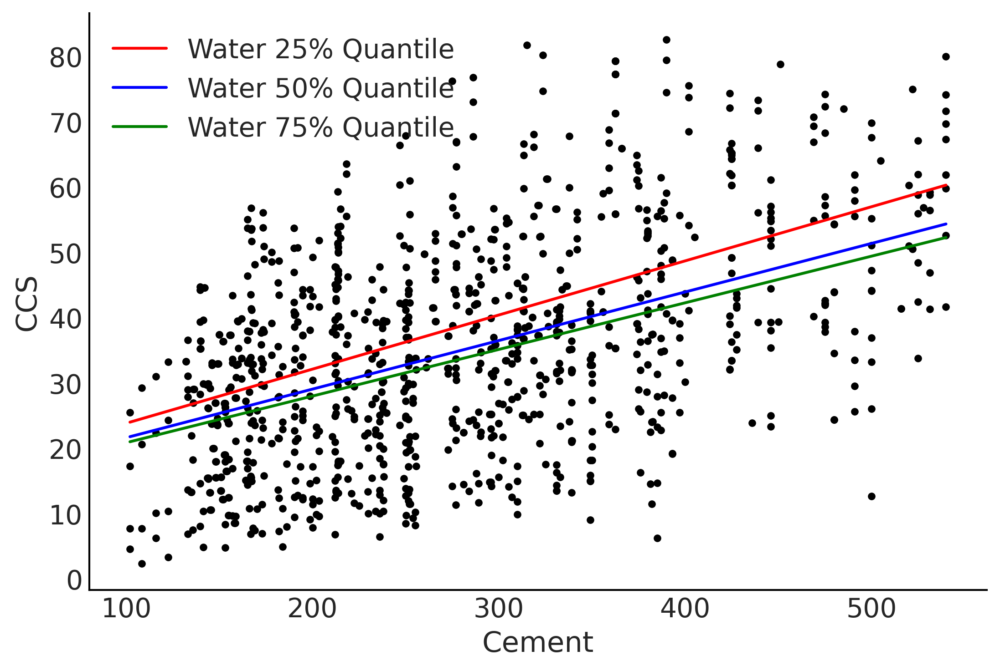

In [139]:
cement=np.sort(concrete['cement'].values)
w25=concrete["water"].quantile(0.25)
w50=concrete["water"].quantile(0.5)
w75=concrete["water"].quantile(0.75)

β0=np.mean(idata['posterior']['β0'].values)
βw=np.mean(idata['posterior']['βw'].values)
βc=np.mean(idata['posterior']['βc'].values)
βwc=np.mean(idata['posterior']['βwc'].values)

plt.scatter(concrete["cement"],concrete["CCS"], marker='.')
plt.plot(cement,β0 + βw*w25 + βc*cement + βwc*w25*cement,'r',label='Water 25% Quantile')
plt.plot(cement,β0 + βw*w5 + βc*cement+ βwc*w5*cement,'b',label='Water 50% Quantile')
plt.plot(cement,β0 + βw*w75 + βc*cement+ βwc*w75*cement,'g',label='Water 75% Quantile')
plt.xlabel('Cement')
plt.ylabel('CCS')
plt.legend()

# 4M12

In [144]:
with pm.Model() as model:
    σ_hyperprior = pm.HalfNormal("σ_hyperprior", 20)
    δ = pm.HalfNormal("δ", sigma=10, shape=(3,2))
    #σ = pm.HalfNormal("σ", σ_hyperprior, shape=3)
    β = pm.Normal("β", mu=10, sigma=20, shape=3)
    μ = pm.Deterministic("μ", β[food_category.codes] * customers)
    
    σ = pm.Deterministic("σ", δ[food_category.codes,0] + δ[food_category.codes,1]*customers)
    sales = pm.Normal("sales", mu=μ, sigma=σ,observed=sales_observed)
    trace = pm.sample(target_accept=.9)
    ppc_sales = pm.sample_posterior_predictive(trace)
    idata= az.from_pymc3(trace=trace,posterior_predictive=ppc_sales, 
        coords={"β_dim_0":food_category.categories,
                "δ_dim_0":food_category.categories,
                "δ_dim_1":['δ0','δ1']})

/tmp/ipykernel_19/1853481130.py:10: FutureWarning: In v4.0, pm.sample will return an `arviz.InferenceData` object instead of a `MultiTrace` by default. You can pass return_inferencedata=True or return_inferencedata=False to be safe and silence this warning.
  trace = pm.sample(target_accept=.9)
Auto-assigning NUTS sampler...
INFO:pymc3:Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
INFO:pymc3:Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (4 chains in 4 jobs)
INFO:pymc3:Multiprocess sampling (4 chains in 4 jobs)
NUTS: [β, δ, σ_hyperprior]
INFO:pymc3:NUTS: [β, δ, σ_hyperprior]


Sampling 4 chains for 1_000 tune and 1_000 draw iterations (4_000 + 4_000 draws total) took 11 seconds.
INFO:pymc3:Sampling 4 chains for 1_000 tune and 1_000 draw iterations (4_000 + 4_000 draws total) took 11 seconds.
There were 2 divergences after tuning. Increase `target_accept` or reparameterize.
ERROR:pymc3:There were 2 divergences after tuning. Increase `target_accept` or reparameterize.
There were 115 divergences after tuning. Increase `target_accept` or reparameterize.
ERROR:pymc3:There were 115 divergences after tuning. Increase `target_accept` or reparameterize.
There was 1 divergence after tuning. Increase `target_accept` or reparameterize.
ERROR:pymc3:There was 1 divergence after tuning. Increase `target_accept` or reparameterize.
The number of effective samples is smaller than 25% for some parameters.
INFO:pymc3:The number of effective samples is smaller than 25% for some parameters.


Text(0.5, 1.0, 'Regression')

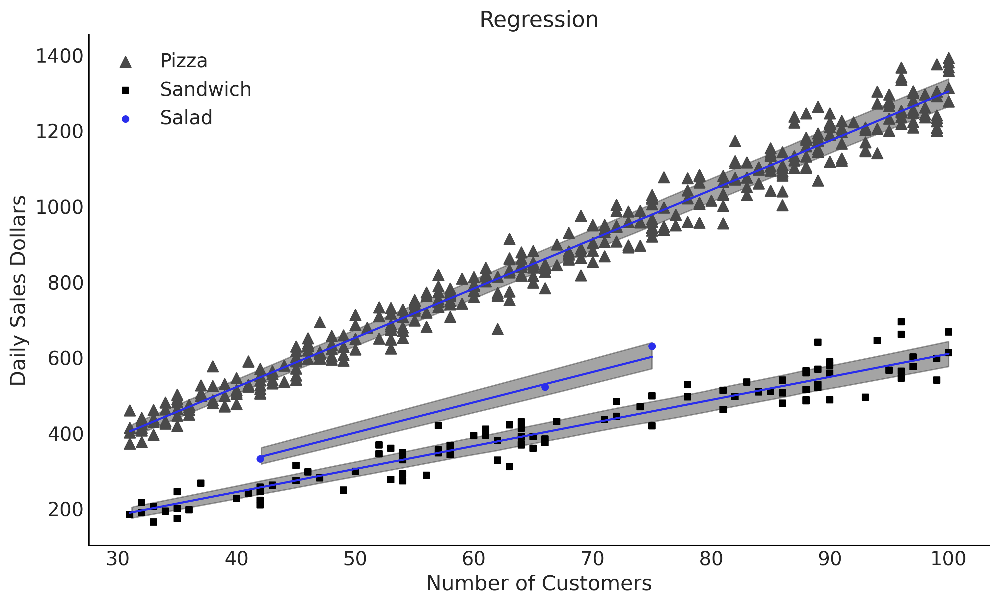

In [145]:
fig, ax = plt.subplots(figsize=(10, 6))
for i in range(3):
    category_mask = (food_category.codes==i)
    μ_m_salads = idata.posterior["μ"][:,:, category_mask].mean(axis=(0,1))
    ax.plot(sales_df.customers[category_mask], μ_m_salads, c='C4')
    az.plot_hdi(sales_df.customers[category_mask], 
                idata.posterior_predictive["sales"][:,:, (category_mask)], 
                hdi_prob=.50, ax=ax, fill_kwargs={"alpha": .5})
pizza_df.plot(x="customers", y="sales", kind="scatter", ax=ax, c="C1", label="Pizza", marker="^", s=60);
sandwich_df.plot(x="customers", y="sales", kind="scatter", ax=ax,  label="Sandwich", marker="s");
salad_df.plot(x="customers", y="sales", kind="scatter", ax=ax, label="Salad", c="C4");

ax.set_xlabel("Number of Customers")
ax.set_ylabel("Daily Sales Dollars")
ax.set_title("Regression")


## 4H13

In [157]:
df= pd.read_csv("../exercises/data/radon.csv")
σ_hyperprior=df.log_radon.std()
mask= df.basement.values=='Y'
with pm.Model() as basement:
    σ = pm.HalfNormal("σ", σ_hyperprior, shape=1)
    β = pm.Normal("β", mu=10, sigma=20, shape=2)
    μ = pm.Deterministic("μ", β[0] + β[1]*mask) 
    y = pm.Normal("y", mu=μ, sigma=σ,observed=df['log_radon'])
    trace = pm.sample(target_accept=.9)
    ppc = pm.sample_posterior_predictive(trace)
    idata1= az.from_pymc3(trace=trace,posterior_predictive=ppc, 
        coords={"β_dim_0":['offset','basement'],
                })

/tmp/ipykernel_19/1747765.py:9: FutureWarning: In v4.0, pm.sample will return an `arviz.InferenceData` object instead of a `MultiTrace` by default. You can pass return_inferencedata=True or return_inferencedata=False to be safe and silence this warning.
  trace = pm.sample(target_accept=.9)
Auto-assigning NUTS sampler...
INFO:pymc3:Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
INFO:pymc3:Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (4 chains in 4 jobs)
INFO:pymc3:Multiprocess sampling (4 chains in 4 jobs)
NUTS: [β, σ]
INFO:pymc3:NUTS: [β, σ]


Sampling 4 chains for 1_000 tune and 1_000 draw iterations (4_000 + 4_000 draws total) took 3 seconds.
INFO:pymc3:Sampling 4 chains for 1_000 tune and 1_000 draw iterations (4_000 + 4_000 draws total) took 3 seconds.


In [159]:
az.summary(idata1, var_names=["β", "σ"], kind="stats").round(1)

,mean,sd,hdi_3%,hdi_97%
β[0],1.0,0.1,0.8,1.1
β[1],0.3,0.1,0.2,0.5
σ[0],0.8,0.0,0.8,0.9


In [170]:
county_obs=pd.Categorical(df.county).codes
counties=pd.Categorical(df.county).categories
C=len(counties)
mu_hyperprior=df.log_radon.mean()

with pm.Model() as hierarchical_basement:
    σ = pm.HalfNormal("σ", σ_hyperprior, shape=1)
    mu0 = pm.Normal("mu0", mu=mu_hyperprior, sigma=σ_hyperprior) 
    mu1 = pm.Normal("mu1", mu=mu_hyperprior, sigma=σ_hyperprior) 
    β0 = pm.Normal("β0", mu=mu0, sigma=σ_hyperprior, shape=C) #County baseline average
    β1 = pm.Normal("β1", mu=mu1, sigma=σ_hyperprior, shape=C) #County effect
    μ = pm.Deterministic("μ", β0[county_obs] + β1[county_obs]*mask) 
    y = pm.Normal("y", mu=μ, sigma=σ,observed=df['log_radon'])
    
    trace = pm.sample(target_accept=.9)
    ppc = pm.sample_posterior_predictive(trace)
    idata2= az.from_pymc3(trace=trace,posterior_predictive=ppc, 
        coords={"β0":counties,"β1":counties,
                })
    

/tmp/ipykernel_19/3745669746.py:15: FutureWarning: In v4.0, pm.sample will return an `arviz.InferenceData` object instead of a `MultiTrace` by default. You can pass return_inferencedata=True or return_inferencedata=False to be safe and silence this warning.
  trace = pm.sample(target_accept=.9)
Auto-assigning NUTS sampler...
INFO:pymc3:Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
INFO:pymc3:Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (4 chains in 4 jobs)
INFO:pymc3:Multiprocess sampling (4 chains in 4 jobs)
NUTS: [β1, β0, mu1, mu0, σ]
INFO:pymc3:NUTS: [β1, β0, mu1, mu0, σ]


Sampling 4 chains for 1_000 tune and 1_000 draw iterations (4_000 + 4_000 draws total) took 12 seconds.
INFO:pymc3:Sampling 4 chains for 1_000 tune and 1_000 draw iterations (4_000 + 4_000 draws total) took 12 seconds.


/usr/local/lib/python3.8/dist-packages/arviz/stats/stats.py:145: UserWarning: The default method used to estimate the weights for each model,has changed from BB-pseudo-BMA to stacking
  warnings.warn(
/usr/local/lib/python3.8/dist-packages/arviz/stats/stats.py:655: UserWarning: Estimated shape parameter of Pareto distribution is greater than 0.7 for one or more samples. You should consider using a more robust model, this is because importance sampling is less likely to work well if the marginal posterior and LOO posterior are very different. This is more likely to happen with a non-robust model and highly influential observations.
  warnings.warn(


,rank,loo,p_loo,d_loo,weight,se,dse,warning,loo_scale
hierarchical_basement,0,-1103.8,97.0,0.0,0.6,29.1,0.0,True,log
basement,1,-1117.0,3.6,13.2,0.4,26.2,13.5,False,log


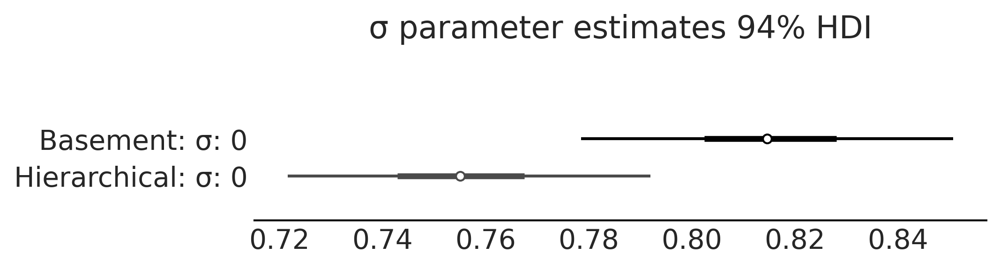

In [171]:
axes = az.plot_forest([idata1,idata2],model_names = ["Basement","Hierarchical"],
                      var_names=["σ"], combined=True, figsize=(7, 1.8));
axes[0].set_title("σ parameter estimates 94% HDI")
az.compare({"basement": idata1,"hierarchical_basement": idata2 }).round(1)

In [182]:
with pm.Model() as centered_basement:
    σ = pm.HalfNormal("σ", σ_hyperprior, shape=1)
    σm = pm.HalfNormal("σn", σ, shape=C)
    βc = pm.Normal("βc", mu=mu_hyperprior, sigma=σ_hyperprior) #County center effect
    βm = pm.Normal("βm", mu=0, sigma=1, shape=C) 
    βs= pm.HalfNormal("βs", σ_hyperprior) 
    
    μ = pm.Deterministic("μ", βc + βm[county_obs]*βs*mask) 
    y = pm.Normal("y", mu=μ, sigma=σm[county_obs],observed=df['log_radon'])
    
    trace = pm.sample(target_accept=.9)
    ppc = pm.sample_posterior_predictive(trace)
    idata3= az.from_pymc3(trace=trace,posterior_predictive=ppc)

/tmp/ipykernel_19/12354476.py:11: FutureWarning: In v4.0, pm.sample will return an `arviz.InferenceData` object instead of a `MultiTrace` by default. You can pass return_inferencedata=True or return_inferencedata=False to be safe and silence this warning.
  trace = pm.sample(target_accept=.9)
Auto-assigning NUTS sampler...
INFO:pymc3:Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
INFO:pymc3:Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (4 chains in 4 jobs)
INFO:pymc3:Multiprocess sampling (4 chains in 4 jobs)
NUTS: [βs, βm, βc, σn, σ]
INFO:pymc3:NUTS: [βs, βm, βc, σn, σ]


Sampling 4 chains for 1_000 tune and 1_000 draw iterations (4_000 + 4_000 draws total) took 8 seconds.
INFO:pymc3:Sampling 4 chains for 1_000 tune and 1_000 draw iterations (4_000 + 4_000 draws total) took 8 seconds.
There were 38 divergences after tuning. Increase `target_accept` or reparameterize.
ERROR:pymc3:There were 38 divergences after tuning. Increase `target_accept` or reparameterize.
There were 37 divergences after tuning. Increase `target_accept` or reparameterize.
ERROR:pymc3:There were 37 divergences after tuning. Increase `target_accept` or reparameterize.
There were 54 divergences after tuning. Increase `target_accept` or reparameterize.
ERROR:pymc3:There were 54 divergences after tuning. Increase `target_accept` or reparameterize.
There were 40 divergences after tuning. Increase `target_accept` or reparameterize.
ERROR:pymc3:There were 40 divergences after tuning. Increase `target_accept` or reparameterize.
The number of effective samples is smaller than 25% for some pa

In [186]:
az.compare({"basement": idata1,"hierarchical_basement": idata2 ,"noncentered": idata3 }).round(1)

/usr/local/lib/python3.8/dist-packages/arviz/stats/stats.py:145: UserWarning: The default method used to estimate the weights for each model,has changed from BB-pseudo-BMA to stacking
  warnings.warn(
/usr/local/lib/python3.8/dist-packages/arviz/stats/stats.py:655: UserWarning: Estimated shape parameter of Pareto distribution is greater than 0.7 for one or more samples. You should consider using a more robust model, this is because importance sampling is less likely to work well if the marginal posterior and LOO posterior are very different. This is more likely to happen with a non-robust model and highly influential observations.
  warnings.warn(
/usr/local/lib/python3.8/dist-packages/arviz/stats/stats.py:655: UserWarning: Estimated shape parameter of Pareto distribution is greater than 0.7 for one or more samples. You should consider using a more robust model, this is because importance sampling is less likely to work well if the marginal posterior and LOO posterior are very differen

,rank,loo,p_loo,d_loo,weight,se,dse,warning,loo_scale
noncentered,0,-1088.3,108.8,0.0,0.4,25.1,0.0,True,log
hierarchical_basement,1,-1103.8,97.0,15.5,0.4,29.1,17.5,True,log
basement,2,-1117.0,3.6,28.7,0.2,26.2,16.0,False,log


## 4H16

In [187]:
df=pd.read_csv("../exercises/data/gravity_measurements.csv")
df

FileNotFoundError: [Errno 2] No such file or directory: '../exercises/data/gravity_measurements.csv'

In [120]:

with pm.Model() as model:
     x = pm.Data('x', [1., 2., 3.])
     z = pm.Data('z', [4., 5., 6.])
     y = pm.Data('y', [5., 7., 9.])
     beta = pm.Normal('beta', 0, 1)
     alpha = pm.Normal('alpha', 0, 1)
     mu = pm.Normal('mu', 0, 1)
     obs = pm.Normal('obs', x * beta + z * alpha + x*z*mu, 1, observed=y)
     trace = pm.sample(1000, tune=1000)
with model:
     pm.set_data({'x': [2,2],'z': [5,6]})
     y_test = pm.sample_posterior_predictive(trace)

50.10047311803057

In [168]:
az.compare({"basement": idata1,"hierarchical_basement": idata2 }).round(1)

/usr/local/lib/python3.8/dist-packages/arviz/stats/stats.py:145: UserWarning: The default method used to estimate the weights for each model,has changed from BB-pseudo-BMA to stacking
  warnings.warn(
/usr/local/lib/python3.8/dist-packages/arviz/stats/stats.py:655: UserWarning: Estimated shape parameter of Pareto distribution is greater than 0.7 for one or more samples. You should consider using a more robust model, this is because importance sampling is less likely to work well if the marginal posterior and LOO posterior are very different. This is more likely to happen with a non-robust model and highly influential observations.
  warnings.warn(


,rank,loo,p_loo,d_loo,weight,se,dse,warning,loo_scale
hierarchical_basement,0,-1090.0,75.0,0.0,0.7,29.3,0.0,True,log
basement,1,-1117.0,3.6,27.0,0.3,26.2,12.6,False,log
